<a href="https://colab.research.google.com/github/traorekitio/dentai-api/blob/main/DentAI_Segmentation_YOLO_Sam2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# NOMS & Prénom(s)
#TRAORE Mounira Kitio Maimouna
#COMPAORE Wendmi Tobi Luzine Fasise

# Introduction

L’intelligence artificielle (IA) transforme de nombreux domaines, y compris la santé. En dentisterie, la majorité des avancées en imagerie assistée par IA se concentrent sur l’analyse des radiographies dentaires. Cependant, dans la pratique quotidienne, les dentistes s’appuient également sur des images classiques prises directement en consultation. Ces images, bien que riches en informations, restent peu exploitées par les outils numériques.

Notre projet s’inscrit dans cette problématique : nous cherchons à développer un modèle de segmentation permettant d’identifier et de délimiter précisément les dents sur des images classiques de la bouche. Cette technologie pourrait apporter une aide précieuse aux dentistes en facilitant l’analyse des images, en améliorant la précision des diagnostics et en accélérant la prise de décision clinique.

# Contexte et Définition du problème

Aujourd’hui, l’analyse dentaire repose principalement sur l’observation visuelle et l’expertise du praticien. Cette approche présente plusieurs limites :


*   Manque d’objectivité : L’interprétation des images peut varier d’un dentiste à un autre.
*   Dépendance à l’expérience : Un dentiste expérimenté identifiera plus rapidement les problèmes qu’un praticien débutant.
*   Temps d’analyse : L’examen des images demande du temps, ce qui peut ralentir le processus de diagnostic.

L’intelligence artificielle et la vision par ordinateur offrent une opportunité d’automatiser la segmentation dentaire, apportant ainsi un soutien aux professionnels de santé. En réduisant la variabilité des analyses entre praticiens, cette approche permettrait de standardiser les diagnostics tout en assurant des détections plus rapides et précises. De plus, elle contribuerait à un meilleur suivi des patients, notamment dans le cadre de traitements orthodontiques ou esthétiques, en fournissant des analyses objectives et reproductibles.

La problématique centrale de notre projet réside donc dans le **développement d’un modèle de segmentation performant, capable d’identifier et de délimiter précisément les dents sur des images classiques de la bouche, tout en assurant une robustesse face aux variations d’éclairage, de position et aux éventuelles obstructions par la langue ou les lèvres.**

# Méthodologie

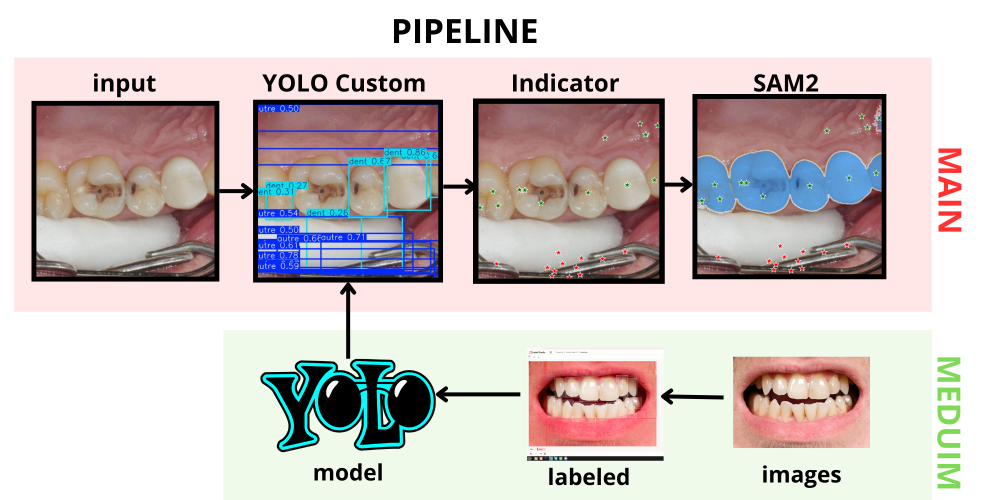

**Automatisation de la Segmentation d'Objets avec YOLO et SAM 2 : Une Méthodologie Innovante**

L’idée derrière notre méthodologie est née de l’exploration du modèle SAM 2 (Segment Anything Model 2) et de sa capacité à segmenter précisément des objets à partir de prompts sous forme de points ou de boîtes englobantes. En testant ce modèle, nous avons compris que son fonctionnement repose sur l’introduction manuelle d’un point de référence accompagné d’un label binaire (1 pour indiquer que le point appartient à l’objet d’intérêt). Une fois ce point défini, SAM 2 génère un ensemble de masques candidats représentant la segmentation possible de l’objet entourant le point sélectionné. L’un des défis majeurs de cette approche est la nécessité d’indiquer manuellement les points de référence, ce qui limite son applicabilité à grande échelle. Pour pallier cette contrainte et automatiser le processus, nous avons eu l’idée d’intégrer un modèle de détection préalable : YOLO. L’objectif était d’utiliser YOLO pour identifier automatiquement les régions d’intérêt dans l’image, puis d’exploiter les coordonnées de ces détections pour fournir les prompts nécessaires à SAM 2, rendant ainsi la segmentation totalement autonome.



---
**Approche en Deux Étapes pour la Segmentation Automatique des Dents : Détection avec YOLO et Segmentation avec SAM 2**


Notre méthodologie repose donc sur une approche en deux étapes. La première consiste en une détection automatique des dents à l’aide d’un modèle YOLO, préalablement entraîné sur un jeu de données annoté en deux classes : « dents » et « autres ». YOLO analyse chaque image et génère des boîtes englobantes autour des régions détectées comme des dents. Chaque boîte est caractérisée par un ensemble de coordonnées (x, y, largeur, hauteur) et est associée à un score de confiance qui permet de filtrer les détections les plus pertinentes. Pour rendre ces résultats exploitables par SAM 2, nous avons extrait le centre de chaque boîte englobante et l’avons enregistré dans un fichier JSON sous la forme de coordonnées utilisables comme prompts.



---
**Phase 2 : Segmentation Automatique avec SAM 2 à partir des Détails YOLO pour une Précision Optimale**

Dans la seconde phase du traitement, les coordonnées des centres des boîtes générées par YOLO servent d’entrées au modèle SAM 2, qui prend en charge la segmentation des dents. Contrairement à une approche nécessitant une intervention humaine, cette méthode automatise totalement l’identification des objets à segmenter. SAM 2, une fois fourni avec ces points et leurs labels (1 pour dent, 0 pour autres), génère plusieurs masques candidats pour chaque point d’entrée. Ces masques sont évalués en fonction de leur score, et nous sélectionnons le masque le plus pertinent pour la segmentation finale. Ce processus permet d’obtenir une segmentation fine et précise, tout en conservant la rapidité d’exécution du modèle YOLO en amont.



---
**Optimisation et Automatisation de la Segmentation d'Objets : Une Méthodologie Combinée YOLO et SAM 2**

Enfin, l’intérêt de cette méthodologie combinée réside dans la complémentarité des deux modèles. YOLO permet une identification rapide des zones d’intérêt sans nécessiter d’annotation manuelle, tandis que SAM 2 affine ces résultats en générant des masques précis. Cette approche nous a permis d’automatiser la segmentation des dents sur des images classiques de la bouche, sans intervention humaine après l’entraînement des modèles. Elle pourrait être adaptée à d’autres contextes nécessitant une segmentation automatique d’objets spécifiques dans des images complexes, en remplaçant simplement le jeu de données et les classes de détection.

# YOLO

In [ ]:
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 921.5/921.5 kB 11.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 3.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 34.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 29.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 41.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 10.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 6.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 65.3 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstall

In [ ]:
import kagglehub
import os
import zipfile
import shutil
from glob import glob
import os
import requests
import json
from ultralytics import YOLO
import cv2


**Télechargement des données sur kaagle**

Ce code télécharge un jeu de données depuis KaggleHub, l'extrait si c'est un fichier ZIP et sélectionne les 10 premières images au format `.jpg`, `.jpeg` ou `.png`. Ces images sont ensuite copiées dans un dossier de destination spécifié. Un message confirme chaque étape du processus.

In [ ]:

# Télécharger le dataset depuis KaggleHub
dataset_path = kagglehub.dataset_download("pawanvalluri/dental-segmentation")
print("✅ Dataset téléchargé :", dataset_path)

# Définir le dossier de destination
destination_folder = "/content/input"
os.makedirs(destination_folder, exist_ok=True)

# Extraire les fichiers s'il s'agit d'un ZIP
if dataset_path.endswith(".zip"):
    extracted_folder = dataset_path.replace(".zip", "")
    with zipfile.ZipFile(dataset_path, "r") as zip_ref:
        zip_ref.extractall(extracted_folder)
    print("✅ Fichiers extraits dans :", extracted_folder)
else:
    extracted_folder = dataset_path  # Si ce n'est pas un ZIP, utiliser directement le chemin

# Trouver les 10 premières images
image_extensions = (".jpg", ".jpeg", ".png")
all_images = sorted(glob(os.path.join(extracted_folder, "**/*"), recursive=True))

image_files = [img for idx, img in enumerate(all_images) if idx % 2 == 0 and img.lower().endswith(image_extensions)][:10]
# Copier les 10 premières images dans le dossier de destination
for img in image_files:
    shutil.copy(img, destination_folder)

print(f"✅ {len(image_files)} images copiées dans {destination_folder}")


✅ Dataset téléchargé : /root/.cache/kagglehub/datasets/pawanvalluri/dental-segmentation/versions/1
✅ 10 images copiées dans /content/input


**création des fichiers**

Ce code crée un fichier YAML pour définir un jeu de données personnalisé. Il spécifie les chemins des dossiers de formation et de validation, le nombre de classes (2) et les noms des classes ('autre' et 'dent'). Le contenu est ensuite écrit dans un fichier à l'emplacement spécifié, et un message confirme la création du fichier.

In [ ]:

# Définition du contenu du fichier
yaml_content = """train: /content/custom_dataset/train
val: /content/custom_dataset/val

nc: 2

names: ['autre', 'dent']
"""


# Définition du chemin du fichier
yaml_path = "/content/model/dataset_custom.yaml"
os.makedirs(os.path.dirname(yaml_path), exist_ok=True)

# Création et écriture du fichier
with open(yaml_path, "w") as file:
    file.write(yaml_content)

print(f"✅ Fichier créé : {yaml_path}")


✅ Fichier créé : /content/model/dataset_custom.yaml


Ce code télécharge un modèle YOLO pré-entrainé depuis une URL, le sauvegarde dans un dossier spécifié et le charge ensuite pour une utilisation ultérieure. Il vérifie d'abord si le dossier existe, crée-le si nécessaire, puis télécharge le modèle par streaming. Si le téléchargement est réussi, le modèle est ensuite chargé avec la bibliothèque `ultralytics`. Un message confirme chaque étape du processus.

In [ ]:
# Définition des chemins
model_dir = "/content/model"
model_path = os.path.join(model_dir, "yolo11m.pt")

# Création du dossier s'il n'existe pas
os.makedirs(model_dir, exist_ok=True)

# URL du modèle (remplace par le lien réel)
model_url = "https://huggingface.co/mbar0075/YOLO-Application-Toolkit/resolve/main/yolo11m.pt?download=true"  # Remplace ceci par le vrai lien

# Téléchargement du modèle
response = requests.get(model_url, stream=True)
if response.status_code == 200:
    with open(model_path, "wb") as file:
        for chunk in response.iter_content(chunk_size=1024):
            file.write(chunk)
    print(f"✅ Modèle téléchargé et enregistré : {model_path}")
else:
    print("❌ Erreur lors du téléchargement")

# Chargement du modèle YOLO
from ultralytics import YOLO
model = YOLO(model_path)
print("✅ Modèle YOLO chargé avec succès !")


✅ Modèle téléchargé et enregistré : /content/model/yolo11m.pt
✅ Modèle YOLO chargé avec succès !


**Entrainement personnalisée du modèle YOLO (yolo11m) à reconnaitre des dents**

Ce code entraîne un modèle YOLO en utilisant un jeu de données personnalisé, spécifié dans un fichier YAML. Il définit les paramètres d'entraînement, comme le nombre d'époques (10), la taille des lots (4), et la taille des images (640x640). L'entraînement est effectué sur le CPU, et les paramètres sont passés à la méthode `train()` de YOLO pour lancer l'entraînement du modèle.

In [ ]:
import os
from googleapiclient.http import MediaIoBaseDownload

from google.colab import auth
from googleapiclient.discovery import build

# Authentification
auth.authenticate_user()

# Initialisation du service Google Drive
from googleapiclient.discovery import build
from google.auth.transport.requests import Request
from google.oauth2 import service_account

# Connexion au service Drive
drive_service = build('drive', 'v3')

# Fonction pour lister les fichiers et sous-dossiers dans un dossier Google Drive
def list_files_in_folder(folder_id):
    query = f"'{folder_id}' in parents"
    results = drive_service.files().list(q=query).execute()
    files = results.get('files', [])
    return files

# Fonction pour télécharger un fichier de Google Drive
def download_file(file_id, destination):
    request = drive_service.files().get_media(fileId=file_id)
    fh = io.FileIO(destination, 'wb')
    downloader = MediaIoBaseDownload(fh, request)
    done = False
    while done is False:
        status, done = downloader.next_chunk()
        print(f"Progression: {int(status.progress() * 100)}%.")
    print(f"Fichier téléchargé vers : {destination}")

# Fonction pour télécharger récursivement un dossier entier et ses sous-dossiers
def download_folder(folder_id, destination_path):
    # Créez le répertoire de destination s'il n'existe pas
    os.makedirs(destination_path, exist_ok=True)

    # Lister les fichiers et sous-dossiers du dossier Google Drive
    files = list_files_in_folder(folder_id)

    for file in files:
        file_name = file['name']
        file_id = file['id']

        if file['mimeType'] == 'application/vnd.google-apps.folder':
            # Si c'est un sous-dossier, appeler la fonction récursive
            new_folder_path = os.path.join(destination_path, file_name)
            print(f"Téléchargement du sous-dossier : {new_folder_path}")
            download_folder(file_id, new_folder_path)
        else:
            # Si c'est un fichier, télécharger le fichier
            print(f"Téléchargement du fichier : {file_name}")
            download_file(file_id, os.path.join(destination_path, file_name))

# Dossier de formation (ID)
folder_train_id = '16xxMZiBM4wJdy9SJNC3V3w5TXV9tXGmF'
# Dossier de validation (ID)
folder_val_id = '1lbodRuenvTjEDuD9fMocQZqE3H3R3d0x'

# Télécharger les dossiers de formation et de validation
download_folder(folder_train_id, '/content/custom_dataset/train/')
download_folder(folder_val_id, '/content/custom_dataset/val/')

print("Tous les fichiers et sous-dossiers ont été téléchargés.")


Tous les fichiers et sous-dossiers ont été téléchargés.


In [ ]:
import gdown
import zipfile
import os
import shutil

# URL du fichier Google Drive (partagé en lien de téléchargement direct)
zip_url = 'https://drive.google.com/uc?id=1mUIYIxQxELMuBEvmI9aWHwAqrYN1z5uC'

# Chemin où le fichier ZIP sera téléchargé
zip_path = '/content/dataset.zip'

# Télécharger le fichier ZIP depuis Google Drive
gdown.download(zip_url, zip_path, quiet=False)

# Décompresser le fichier ZIP
extracted_folder_path = '/content/extracted_dataset'

# Créer le répertoire d'extraction s'il n'existe pas
os.makedirs(extracted_folder_path, exist_ok=True)

# Décompresser le fichier ZIP
with zipfile.ZipFile(zip_path, 'r') as zip_ref:
    zip_ref.extractall(extracted_folder_path)

# Déplacer le contenu décompressé dans le dossier de destination
destination_path = '/content/custom_dataset'  # Dossier cible

# Créer le dossier cible s'il n'existe pas
os.makedirs(destination_path, exist_ok=True)

# Déplacer tous les fichiers et sous-dossiers sans conserver le dossier parent
for item in os.listdir(extracted_folder_path):
    source_path = os.path.join(extracted_folder_path, item)

    # Si c'est un dossier, copier son contenu sans conserver le parent
    if os.path.isdir(source_path):
        for sub_item in os.listdir(source_path):  # Parcourir les éléments à l'intérieur du dossier
            sub_item_path = os.path.join(source_path, sub_item)
            destination_item_path = os.path.join(destination_path, sub_item)

            # Copier les fichiers ou sous-dossiers dans le dossier de destination
            if os.path.isdir(sub_item_path):
                # Copier les sous-dossiers avec remplacement en cas d'existence
                shutil.copytree(sub_item_path, destination_item_path, dirs_exist_ok=True)
            else:
                shutil.copy(sub_item_path, destination_item_path)  # Copier les fichiers
    else:
        shutil.copy(source_path, os.path.join(destination_path, item))  # Copier le fichier

# Nettoyer les fichiers temporaires (fichier ZIP et dossier extrait)
os.remove(zip_path)
shutil.rmtree(extracted_folder_path)

print(f"Le contenu a été téléchargé, décompressé et déplacé vers {destination_path}")


Downloading...
From: https://drive.google.com/uc?id=1mUIYIxQxELMuBEvmI9aWHwAqrYN1z5uC
To: /content/dataset.zip
100%|██████████| 1.80M/1.80M [00:00<00:00, 173MB/s]

Le contenu a été téléchargé, décompressé et déplacé vers /content/custom_dataset


In [ ]:
model = YOLO('/content/model/yolo11m.pt')
os.makedirs(os.path.dirname(yaml_path), exist_ok=True)

model.train(
    data='/content/model/dataset_custom.yaml',
    epochs=10,
    batch=4,               # Remplacez 'batch_size' par 'batch'
    imgsz=640,             # Remplacez 'img_size' par 'imgsz'
    device='cpu',         # Ok, aucun changement ici
)


Ultralytics 8.3.78 🚀 Python-3.11.11 torch-2.5.1+cu124 CPU (Intel Xeon 2.00GHz)
engine/trainer: task=detect, mode=train, model=/content/model/yolo11m.pt, data=/content/model/dataset_custom.yaml, epochs=10, time=None, patience=100, batch=4, imgsz=640, save=True, save_period=-1, cache=False, device=cpu, workers=8, project=None, name=train2, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_co

train: Scanning /content/custom_dataset/train/labels... 2 images, 0 backgrounds, 0 corrupt: 100%|██████████| 2/2 [00:00<00:00, 984.46it/s]

train: New cache created: /content/custom_dataset/train/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/custom_dataset/val/labels... 1 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1/1 [00:00<00:00, 989.92it/s]

val: New cache created: /content/custom_dataset/val/labels.cache
Plotting labels to runs/detect/train2/labels.jpg... 


optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001667, momentum=0.9) with parameter groups 106 weight(decay=0.0), 113 weight(decay=0.0005), 112 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to runs/detect/train2
Starting training for 10 epochs...
Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/10         0G       2.51      3.564      2.437         32        640: 100%|██████████| 1/1 [00:08<00:00,  8.11s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.33it/s]

                   all          1         20     0.0105      0.281     0.0196    0.00673



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/10         0G      2.585      3.145      2.457         32        640: 100%|██████████| 1/1 [00:06<00:00,  6.93s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.02s/it]

                   all          1         20     0.0497        0.5     0.0735     0.0416



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/10         0G      2.441      3.032      2.164         32        640: 100%|██████████| 1/1 [00:06<00:00,  6.52s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.36it/s]

                   all          1         20      0.471      0.344      0.462      0.293



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/10         0G      2.364      2.274      1.893         32        640: 100%|██████████| 1/1 [00:07<00:00,  7.26s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.36it/s]

                   all          1         20      0.997        0.5      0.527      0.321



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/10         0G      2.475      2.412      1.982         32        640: 100%|██████████| 1/1 [00:07<00:00,  7.11s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.33it/s]

                   all          1         20      0.997        0.5      0.527      0.321



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/10         0G      2.266      2.187      1.759         32        640: 100%|██████████| 1/1 [00:06<00:00,  6.37s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.37it/s]

                   all          1         20      0.944        0.5       0.67      0.377



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/10         0G      1.962      1.583      1.684         31        640: 100%|██████████| 1/1 [00:06<00:00,  6.60s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.36it/s]

                   all          1         20      0.944        0.5       0.67      0.377



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/10         0G      2.108      1.578      1.662         32        640: 100%|██████████| 1/1 [00:07<00:00,  7.24s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.40it/s]

                   all          1         20      0.681      0.625       0.63      0.388



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/10         0G      2.114      1.803      1.686         32        640: 100%|██████████| 1/1 [00:05<00:00,  5.90s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.24it/s]

                   all          1         20      0.681      0.625       0.63      0.388



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/10         0G      1.816      1.427      1.516         32        640: 100%|██████████| 1/1 [00:06<00:00,  6.23s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.40it/s]

                   all          1         20      0.765      0.625       0.63      0.406



10 epochs completed in 0.029 hours.
Optimizer stripped from runs/detect/train2/weights/last.pt, 40.5MB
Optimizer stripped from runs/detect/train2/weights/best.pt, 40.5MB

Validating runs/detect/train2/weights/best.pt...
Ultralytics 8.3.78 🚀 Python-3.11.11 torch-2.5.1+cu124 CPU (Intel Xeon 2.00GHz)
YOLO11m summary (fused): 125 layers, 20,031,574 parameters, 0 gradients, 67.7 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.06it/s]


                   all          1         20      0.751      0.625       0.63      0.406
                 autre          1          4      0.854       0.25      0.271      0.202
                  dent          1         16      0.647          1      0.988      0.609
Speed: 1.5ms preprocess, 829.8ms inference, 0.0ms loss, 18.9ms postprocess per image
Results saved to runs/detect/train2


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7f692db85310>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.04804

**Prédictions avec le model YOLO**

Ce code effectue des prédictions sur un ensemble d'images à l'aide d'un modèle YOLO pré-entrainé. Il vérifie si les classes attendues ('dent' et 'autre') sont présentes dans le modèle et effectue l'inférence pour chaque image du dossier spécifié. Pour chaque prédiction, il calcule les centres des objets détectés, les classe, et les enregistre dans un fichier JSON. Les images avec détections sont également sauvegardées dans un dossier de sortie. Un message indique si chaque image a été traitée avec succès.

In [ ]:
import re

# Définition des chemins
input_folder = "/content/input"  # Remplace avec le chemin du dossier contenant les images
output_folder = "/content/sortie1"  # Dossier où seront enregistrées les images avec détections
json_folder = "/content/json"  # Dossier pour enregistrer les fichiers JSON
os.makedirs(output_folder, exist_ok=True)
os.makedirs(json_folder, exist_ok=True)

# Charger le modèle YOLO entraîné
# Dossier où les modèles sont sauvegardés
base_dir = '/content/runs/detect/'

# Trouver tous les répertoires qui commencent par 'train' suivi d'un numéro
train_dirs = [d for d in os.listdir(base_dir) if re.match(r'train(\d+)', d)]

# Trouver le numéro maximum dans les répertoires
max_train_num = max([int(re.search(r'\d+', d).group()) for d in train_dirs])

# Créer le chemin du meilleur modèle en utilisant le répertoire avec le plus grand numéro
best_model_path = f"{base_dir}train{max_train_num}/weights/best.pt"

# Charger le modèle
model = YOLO(best_model_path)

# Afficher le chemin du modèle chargé
print(f"Modèle chargé depuis : {best_model_path}")




# Lire les noms des classes détectées par le modèle
class_names = model.names  # Dictionnaire des classes {0: 'dent', 1: 'autre'}

# Vérification des classes attendues
class_mapping = {name: idx for idx, name in class_names.items()}

if "dent" not in class_mapping or "autre" not in class_mapping:
    raise ValueError("Les classes 'dent' et 'autre' ne sont pas trouvées dans le modèle !")

# Boucle sur toutes les images du dossier
for img_name in os.listdir(input_folder):
    img_path = os.path.join(input_folder, img_name)

    # Vérifier si le fichier est bien une image
    if not img_name.lower().endswith((".jpg", ".jpeg", ".png")):
        print(f"⏩ Ignoré (non-image) : {img_name}")
        continue

    try:
        # Faire l'inférence avec YOLO
        results = model(img_path, save=True, project=output_folder, exist_ok=True)

        # Initialiser les dictionnaires pour les centres
        centers = {"dent": [], "autre": []}

        for result in results:
            for box in result.boxes:
                cls = int(box.cls[0])  # Classe prédite
                conf = float(box.conf[0])  # Confiance
                xyxy = box.xyxy[0].tolist()  # Coordonnées (x1, y1, x2, y2)

                # Calcul du centre (x, y)
                x_center = (xyxy[0] + xyxy[2]) / 2
                y_center = (xyxy[1] + xyxy[3]) / 2

                # Ajouter au bon groupe
                class_label = class_names[cls]
                if class_label in centers:
                    centers[class_label].append((x_center, y_center))

        # Sauvegarde des résultats en JSON
        json_path = os.path.join(json_folder, f"{os.path.splitext(img_name)[0]}.json")
        with open(json_path, "w") as json_file:
            json.dump(centers, json_file, indent=4)

        print(f"✅ Prédictions enregistrées pour {img_name}")

    except Exception as e:
        print(f"❌ Erreur avec {img_name} : {e}")

print("🚀 Traitement terminé !")


Modèle chargé depuis : /content/runs/detect/train2/weights/best.pt

image 1/1 /content/input/1070_jpg.rf.dd831d8387f34ee99265bdc105d2227b.jpg: 448x640 1 autre, 9 dents, 63.3ms
Speed: 3.6ms preprocess, 63.3ms inference, 182.9ms postprocess per image at shape (1, 3, 448, 640)
Results saved to /content/sortie1/predict
✅ Prédictions enregistrées pour 1070_jpg.rf.dd831d8387f34ee99265bdc105d2227b.jpg

image 1/1 /content/input/1082_jpg.rf.9a662eeaf4ff841957126fd7c30f40e4.jpg: 384x640 15 dents, 58.2ms
Speed: 3.8ms preprocess, 58.2ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)
Results saved to /content/sortie1/predict
✅ Prédictions enregistrées pour 1082_jpg.rf.9a662eeaf4ff841957126fd7c30f40e4.jpg

image 1/1 /content/input/107_jpg.rf.921a4da098463349f34c844ce14a390d.jpg: 448x640 6 dents, 56.4ms
Speed: 4.2ms preprocess, 56.4ms inference, 1.6ms postprocess per image at shape (1, 3, 448, 640)
Results saved to /content/sortie1/predict
✅ Prédictions enregistrées pour 107_jpg.rf.

**Organiser les données en dictionnaire**

Ce code consolide les résultats d'inférence pour toutes les images d'un dossier donné, en associant chaque image à ses prédictions (dents et autres) extraites des fichiers JSON correspondants. Pour chaque image, il vérifie si un fichier JSON existe, lit les coordonnées des objets détectés, puis les ajoute à une liste. Une fois toutes les données collectées, elles sont sauvegardées dans un fichier JSON final pour un traitement ou une analyse ultérieure.

In [ ]:
# Définir les dossiers d'entrée
image_folder = "dossier_images"  # Dossier des images
json_folder = "dossier_json"  # Dossier des JSONs
# Définition des chemins
image_folder = "/content/input"  # Remplace avec le chemin du dossier contenant les images
json_folder = "/content/json"  # Dossier pour enregistrer les fichiers JSON
output_json = "/content/json/resultats_complets" # Nom du fichier final

# Initialiser la structure finale
results = []

# Lire toutes les images du dossier
for img_name in os.listdir(image_folder):
    if img_name.lower().endswith((".jpg", ".jpeg", ".png")):
        img_path = os.path.join(image_folder, img_name)
        json_path = os.path.join(json_folder, f"{os.path.splitext(img_name)[0]}.json")

        # Vérifier si le fichier JSON correspondant existe
        if os.path.exists(json_path):
            try:
                with open(json_path, "r") as json_file:
                    json_data = json.load(json_file)

                # Extraire les coordonnées des classes
                dents = json_data.get("dent", [])
                autres = json_data.get("autre", [])

                # Ajouter les données consolidées
                results.append({
                    "image_path": img_path,
                    "dent": dents,
                    "autre": autres
                })

            except Exception as e:
                print(f"❌ Erreur en lisant {json_path} : {e}")
        else:
            print(f"⚠️ JSON non trouvé pour {img_name}")

# Sauvegarder les résultats consolidés
with open(output_json, "w") as output_file:
    json.dump(results, output_file, indent=4)

print(f"🚀 Résultats enregistrés dans {output_json}")


🚀 Résultats enregistrés dans /content/json/resultats_complets


# SAM2 (Running Segment Anything Model 2)

Ce code permet de monter Google Drive dans un environnement Google Colab, ce qui permet d'accéder aux fichiers stockés dans le Drive directement depuis Colab. Après avoir monté le Drive, il change le répertoire de travail courant pour celui spécifié dans `MyDrive`, permettant ainsi d'interagir avec les fichiers et dossiers de Google Drive.

In [ ]:
# Mount the Gdrive
from google.colab import drive
drive.mount('/content/gdrive')
# Change the Current working Directory to your Gdrive
%cd /content/gdrive/MyDrive/

Mounted at /content/gdrive
/content/gdrive/MyDrive


**Clone SAM2 model**

Ce code clone un projet GitHub (`segment-anything-2`) depuis le dépôt de Facebook Research vers votre espace de travail Colab. Une fois le projet cloné, il change le répertoire de travail pour le dossier du projet dans Google Drive. Ensuite, il installe le package Python du projet localement en utilisant `pip install -e .`, ce qui permet d'installer le package en mode développement. Après l'installation, il change de répertoire pour télécharger les poids du modèle dans le dossier `checkpoints`. Enfin, il revient au répertoire principal du projet.

In [ ]:
# Clone the github project
!git clone https://github.com/facebookresearch/segment-anything-2.git

# Change the current working Directory
%cd /content/gdrive/MyDrive/segment-anything-2
# Check your current working Directory
!pwd
# Install the package
print('Attendre, prends beaucoup de temps')
%pip install -e .

# Change the CWD to checkpoints and donwload the model weights
%cd /content/gdrive/MyDrive/segment-anything-2/checkpoints/

# Change the Current working Directory to the root of the project
%cd /content/gdrive/MyDrive/segment-anything-2/



Cloning into 'segment-anything-2'...
remote: Enumerating objects: 1070, done.
remote: Total 1070 (delta 0), reused 0 (delta 0), pack-reused 1070 (from 1)
Receiving objects: 100% (1070/1070), 134.70 MiB | 11.91 MiB/s, done.
Resolving deltas: 100% (376/376), done.
Updating files: 100% (569/569), done.
/content/gdrive/MyDrive/segment-anything-2
/content/gdrive/MyDrive/segment-anything-2
Attendre, prends beaucoup de temps
Obtaining file:///content/gdrive/MyDrive/segment-anything-2
  Installing build dependencies ... done
  Checking if build backend supports build_editable ... done
  Getting requirements to build editable ... done
  Preparing editable metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 42.2/42.2 kB 4.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.0/117.0 kB 12.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.5/154.5 kB 12.9 M

/content/gdrive/MyDrive/segment-anything-2/checkpoints
/content/gdrive/MyDrive/segment-anything-2


**Masques d'objets dans les images à partir de requêtes avec SAM 2.**

import des bibliothèques

In [ ]:
import torch
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
from sam2.build_sam import build_sam2
from sam2.sam2_image_predictor import SAM2ImagePredictor


Ce code optimise les calculs sur GPU en utilisant `bfloat16` et `tf32` pour une meilleure performance. Il définit des fonctions pour afficher des masques de segmentation, des points d'intérêt et des boîtes autour des objets détectés dans des images. Enfin, il charge un modèle pré-entrainé, `SAM2ImagePredictor`, pour effectuer des prédictions de segmentation d'images.

In [ ]:
# use bfloat16 for the entire notebook
torch.autocast(device_type="cuda", dtype=torch.bfloat16).__enter__()

if torch.cuda.get_device_properties(0).major >= 8:
    # turn on tfloat32 for Ampere GPUs (https://pytorch.org/docs/stable/notes/cuda.html#tensorfloat-32-tf32-on-ampere-devices)
    torch.backends.cuda.matmul.allow_tf32 = True
    torch.backends.cudnn.allow_tf32 = True

def show_mask(mask, ax, random_color=False, borders = True):
    if random_color:
        color = np.concatenate([np.random.random(3), np.array([0.6])], axis=0)
    else:
        color = np.array([30/255, 144/255, 255/255, 0.6])
    h, w = mask.shape[-2:]
    mask = mask.astype(np.uint8)
    mask_image =  mask.reshape(h, w, 1) * color.reshape(1, 1, -1)
    if borders:
        import cv2
        contours, _ = cv2.findContours(mask,cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)
        # Try to smooth contours
        contours = [cv2.approxPolyDP(contour, epsilon=0.01, closed=True) for contour in contours]
        mask_image = cv2.drawContours(mask_image, contours, -1, (1, 1, 1, 0.5), thickness=2)
    ax.imshow(mask_image)

def show_points(coords, labels, ax, marker_size=375):
    pos_points = coords[labels==1]
    neg_points = coords[labels==0]
    ax.scatter(pos_points[:, 0], pos_points[:, 1], color='green', marker='*', s=marker_size, edgecolor='white', linewidth=1.25)
    ax.scatter(neg_points[:, 0], neg_points[:, 1], color='red', marker='*', s=marker_size, edgecolor='white', linewidth=1.25)

def show_box(box, ax):
    x0, y0 = box[0], box[1]
    w, h = box[2] - box[0], box[3] - box[1]
    ax.add_patch(plt.Rectangle((x0, y0), w, h, edgecolor='green', facecolor=(0, 0, 0, 0), lw=2))

def show_masks(image, masks, scores, point_coords=None, box_coords=None, input_labels=None, borders=True):
    for i, (mask, score) in enumerate(zip(masks, scores)):
        plt.figure(figsize=(10, 10))
        plt.imshow(image)
        show_mask(mask, plt.gca(), borders=borders)
        if point_coords is not None:
            assert input_labels is not None
            show_points(point_coords, input_labels, plt.gca())
        if box_coords is not None:
            # boxes
            show_box(box_coords, plt.gca())
        if len(scores) > 1:
            plt.title(f"Mask {i+1}, Score: {score:.3f}", fontsize=18)
        plt.axis('off')
        plt.show()


predictor = SAM2ImagePredictor.from_pretrained("facebook/sam2-hiera-large")

# Prédictions

import des bibliothèques

In [ ]:
import os
import json
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image

Ce code charge des images et leurs fichiers JSON associés contenant des points d'intérêt, puis utilise un modèle de segmentation pour prédire des masques sur les objets détectés. Après avoir trié les résultats par score, il affiche les masques, les points d'intérêt et les boîtes autour des objets. Les résultats sont ensuite visualisés, et un fichier de sortie est généré pour chaque image. Si des erreurs se produisent, elles sont capturées et affichées.

les input : [[     113.91        1704]
 [       3645      284.01]
 [     662.17      2436.1]
 [     2053.3      1269.7]
 [     1354.7      1154.2]
 [     1992.6      1111.7]
 [     1992.6      1233.2]
 [       2029      1269.7]
 [     1075.3      1196.8]
 [     1354.7      1898.4]]
labels : [1 1 1 1 1 1 1 1 1 0]


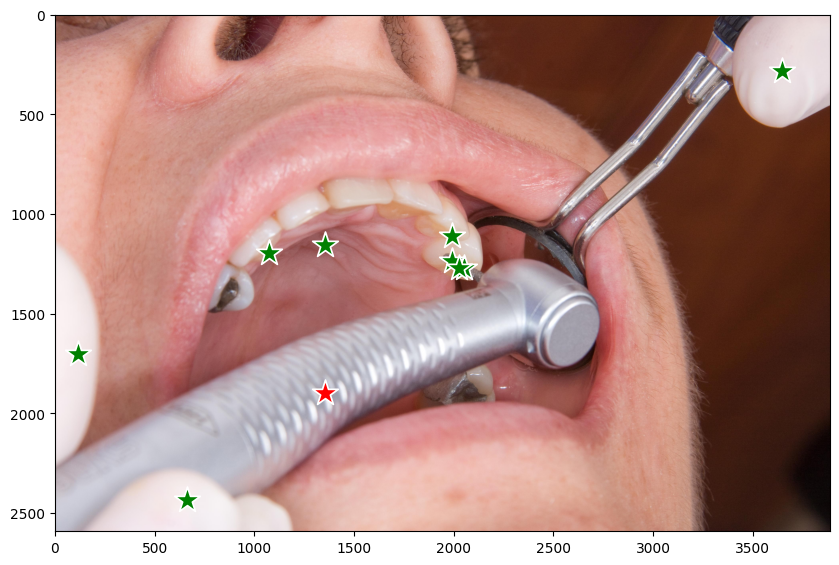

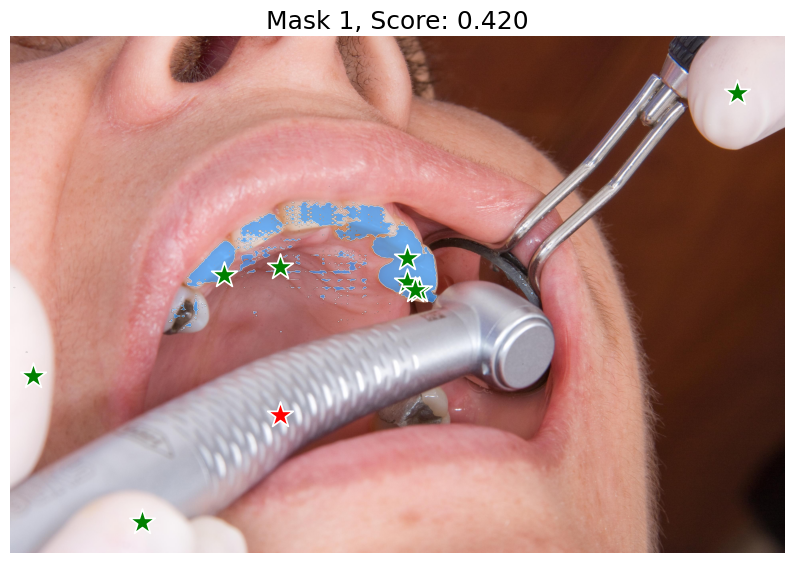

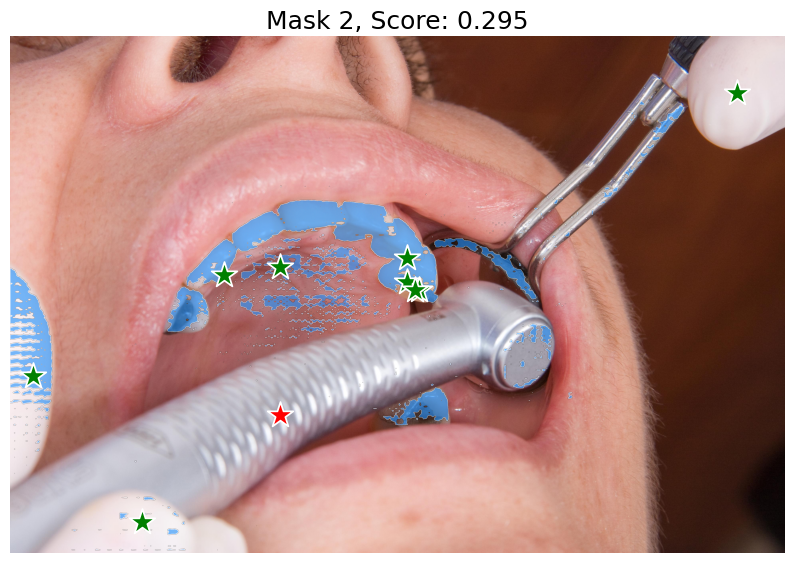

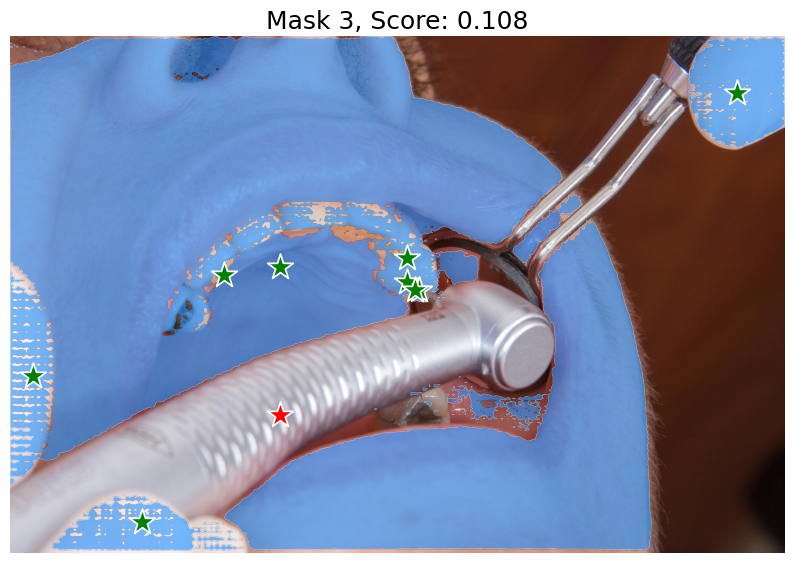

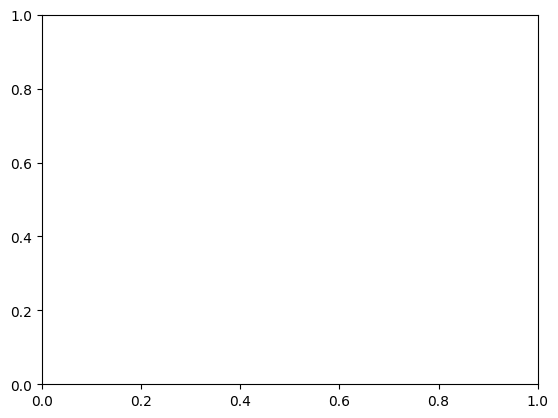

❌ Erreur lors du traitement de [[[112  71  67]
  [120  79  75]
  [124  83  79]
  ...
  [229 213 214]
  [229 213 214]
  [229 213 214]]

 [[113  72  68]
  [121  80  76]
  [125  84  80]
  ...
  [229 213 214]
  [229 213 214]
  [229 213 214]]

 [[115  74  68]
  [122  81  75]
  [126  85  79]
  ...
  [229 213 214]
  [229 213 214]
  [229 213 214]]

 ...

 [[194 193 207]
  [194 193 207]
  [194 193 207]
  ...
  [ 32  20  20]
  [ 32  20  20]
  [ 32  20  20]]

 [[194 193 207]
  [194 193 207]
  [194 193 207]
  ...
  [ 37  25  25]
  [ 36  24  24]
  [ 34  22  22]]

 [[194 193 207]
  [194 193 207]
  [194 193 207]
  ...
  [ 42  30  30]
  [ 39  27  27]
  [ 36  24  24]]] : Format '\n  [ 42  30  30]\n  [ 39  27  27]\n  [ 36  24  24]]]' is not supported (supported formats: eps, jpeg, jpg, pdf, pgf, png, ps, raw, rgba, svg, svgz, tif, tiff, webp)
les input : [[       2172         996]
 [       2544        1104]
 [       2808        1080]
 [       1716        1008]
 [       2292        1356]
 [       1716   

<Figure size 640x480 with 0 Axes>

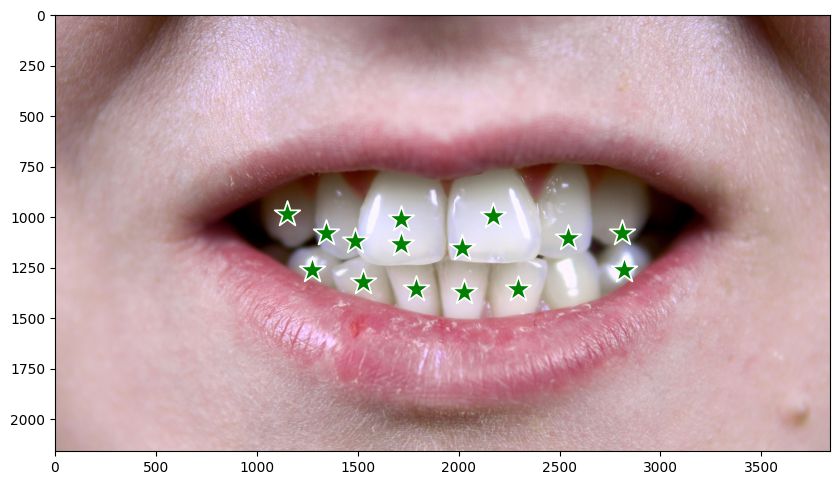

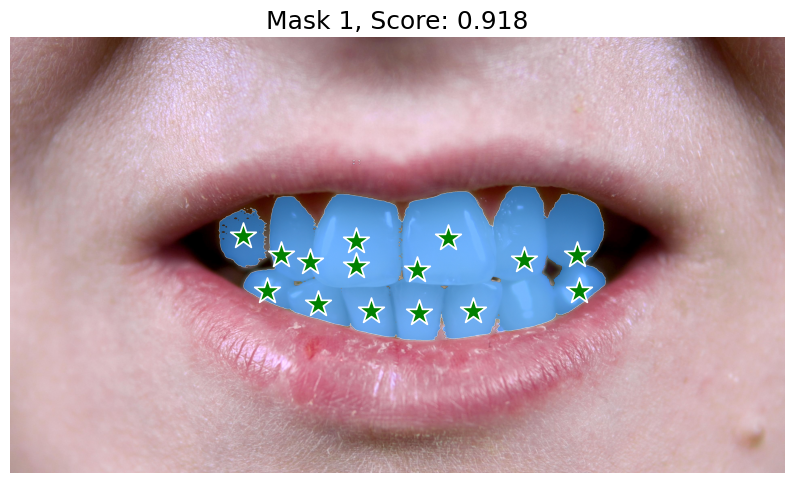

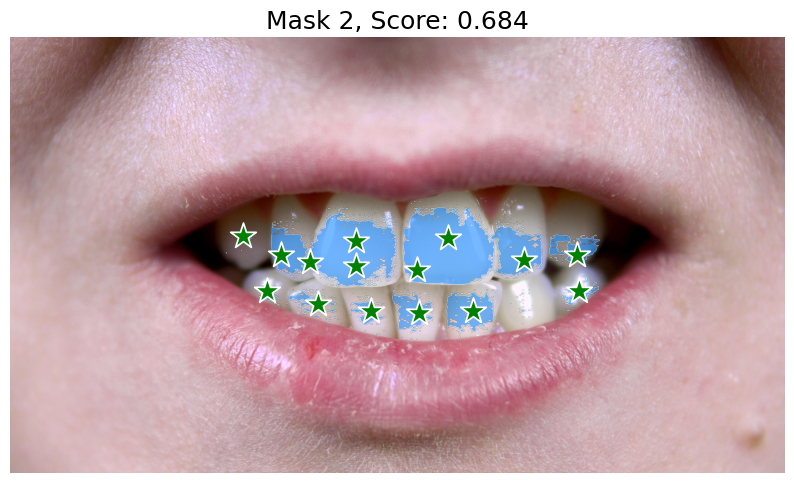

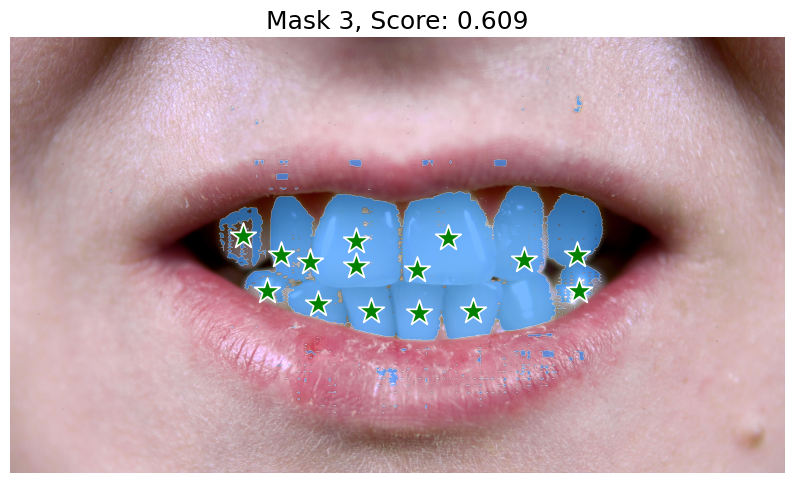

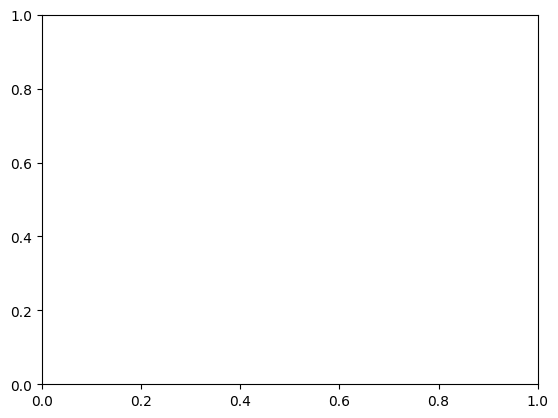

❌ Erreur lors du traitement de [[[178 142 146]
  [178 142 146]
  [177 141 145]
  ...
  [132  91  89]
  [132  91  89]
  [132  91  89]]

 [[180 144 148]
  [180 144 148]
  [180 144 148]
  ...
  [131  90  88]
  [131  90  88]
  [131  90  88]]

 [[181 145 149]
  [182 146 150]
  [184 148 152]
  ...
  [131  90  88]
  [131  90  88]
  [131  90  88]]

 ...

 [[179 150 152]
  [179 150 152]
  [178 149 151]
  ...
  [196 171 174]
  [196 171 174]
  [196 171 174]]

 [[180 151 153]
  [180 151 153]
  [179 150 152]
  ...
  [196 171 174]
  [196 171 174]
  [196 171 174]]

 [[183 154 156]
  [183 154 156]
  [182 153 155]
  ...
  [196 171 174]
  [196 171 174]
  [196 171 174]]] : Format '\n  [196 171 174]\n  [196 171 174]\n  [196 171 174]]]' is not supported (supported formats: eps, jpeg, jpg, pdf, pgf, png, ps, raw, rgba, svg, svgz, tif, tiff, webp)
les input : [[     233.32      1025.1]
 [      810.9      1139.8]
 [     1484.1      1162.8]
 [     2218.5      1292.8]
 [     1973.7      1086.3]
 [     3304.8   

<Figure size 640x480 with 0 Axes>

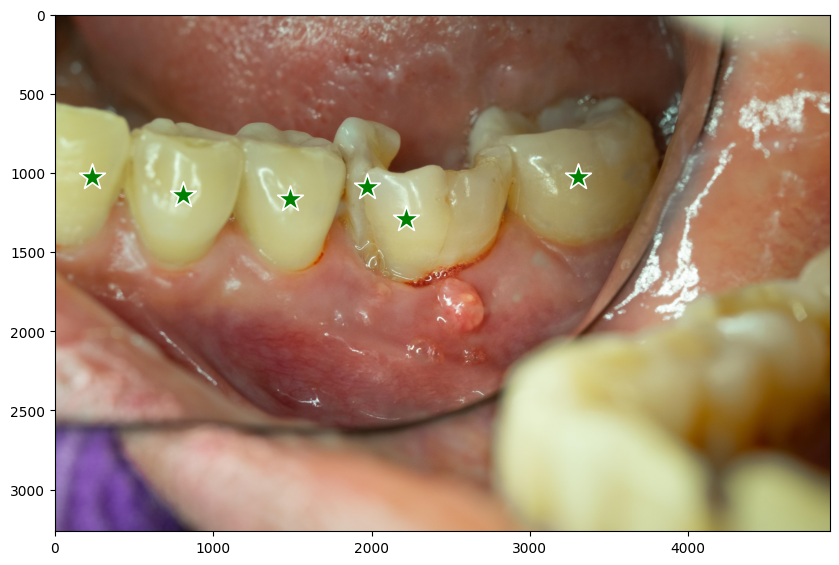

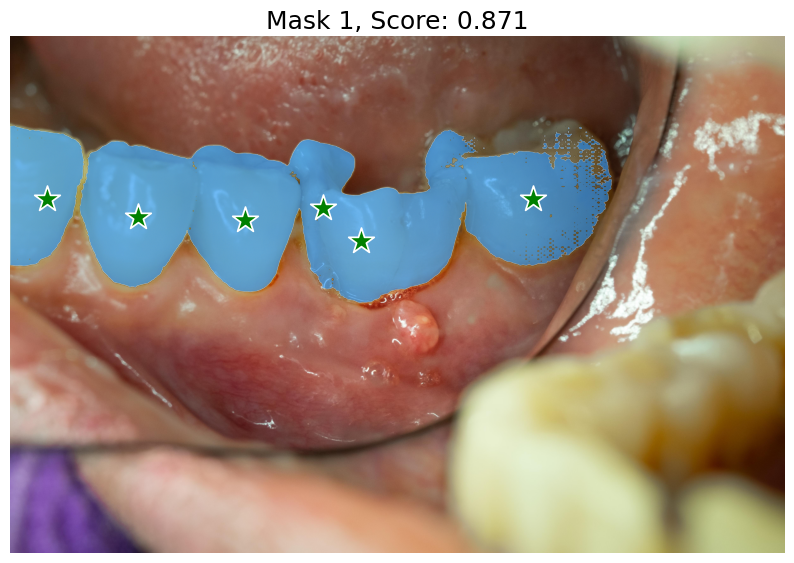

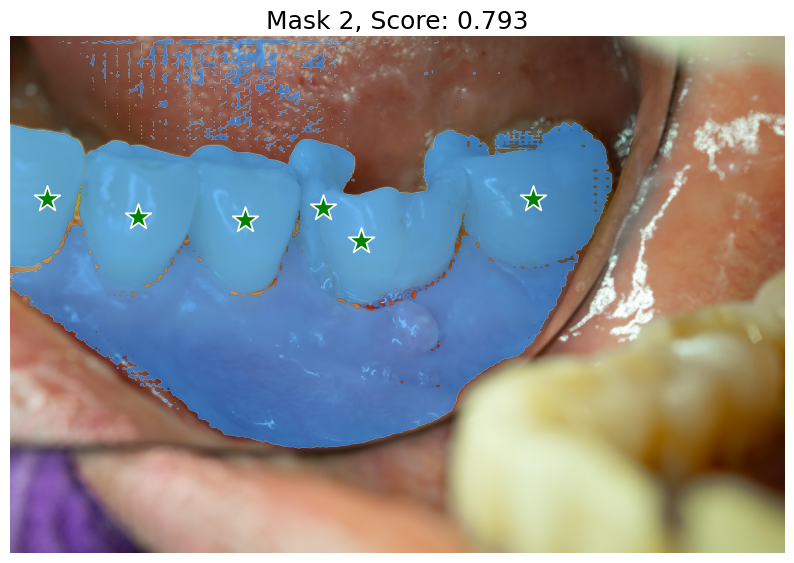

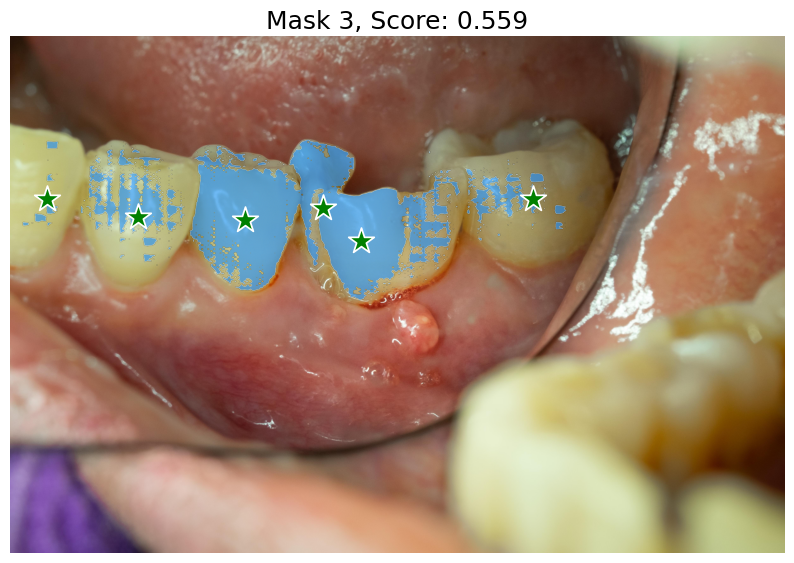

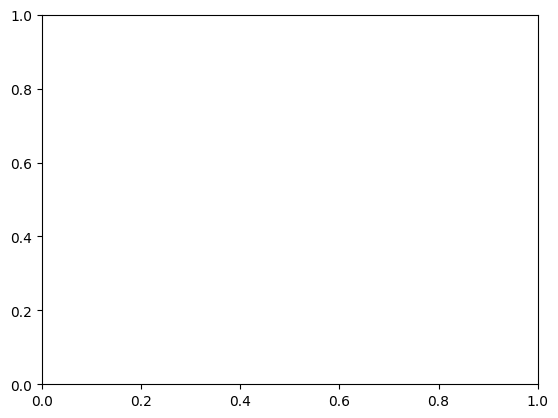

❌ Erreur lors du traitement de [[[ 37  19   9]
  [ 38  20  10]
  [ 40  22  12]
  ...
  [175 166 137]
  [175 166 137]
  [175 166 137]]

 [[ 38  20  10]
  [ 39  21  11]
  [ 41  23  13]
  ...
  [176 167 138]
  [176 167 138]
  [176 167 138]]

 [[ 38  20  10]
  [ 39  21  11]
  [ 41  23  13]
  ...
  [176 167 138]
  [176 167 138]
  [176 167 138]]

 ...

 [[123  95 154]
  [123  95 154]
  [123  95 154]
  ...
  [174 179 115]
  [174 179 115]
  [174 179 115]]

 [[123  95 154]
  [123  95 154]
  [123  95 154]
  ...
  [174 179 115]
  [174 179 115]
  [174 179 115]]

 [[123  95 154]
  [123  95 154]
  [123  95 154]
  ...
  [174 179 115]
  [174 179 115]
  [174 179 115]]] : Format '\n  [174 179 115]\n  [174 179 115]\n  [174 179 115]]]' is not supported (supported formats: eps, jpeg, jpg, pdf, pgf, png, ps, raw, rgba, svg, svgz, tif, tiff, webp)
les input : [[     2905.7      1245.3]
 [       3243      1310.2]
 [     948.57      1310.2]
 [     1238.8      2166.3]
 [     1971.7      2257.1]
 [       2309   

<Figure size 640x480 with 0 Axes>

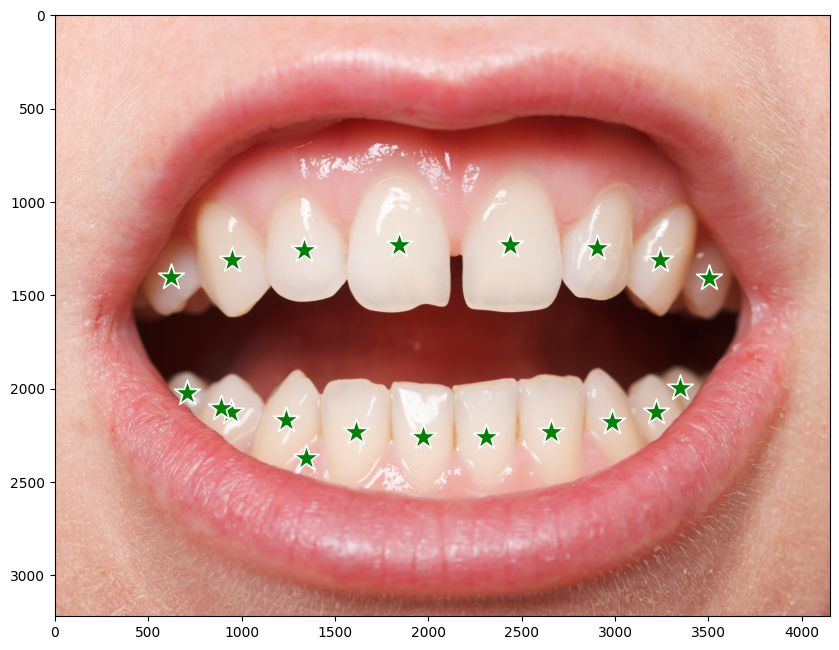

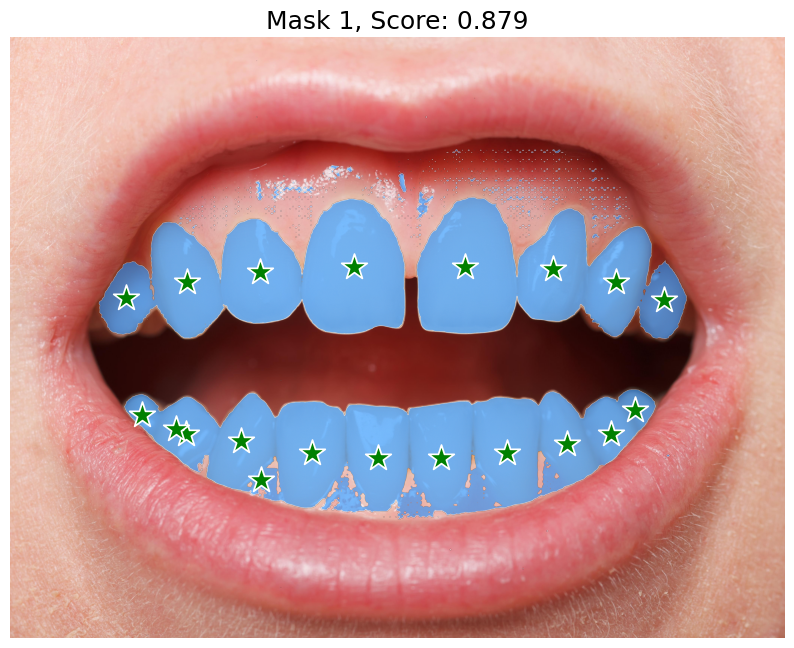

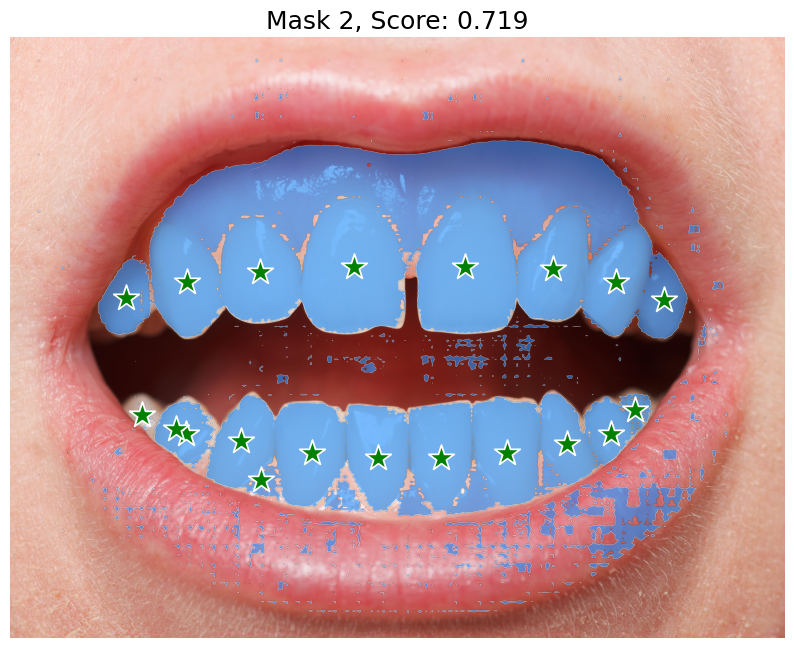

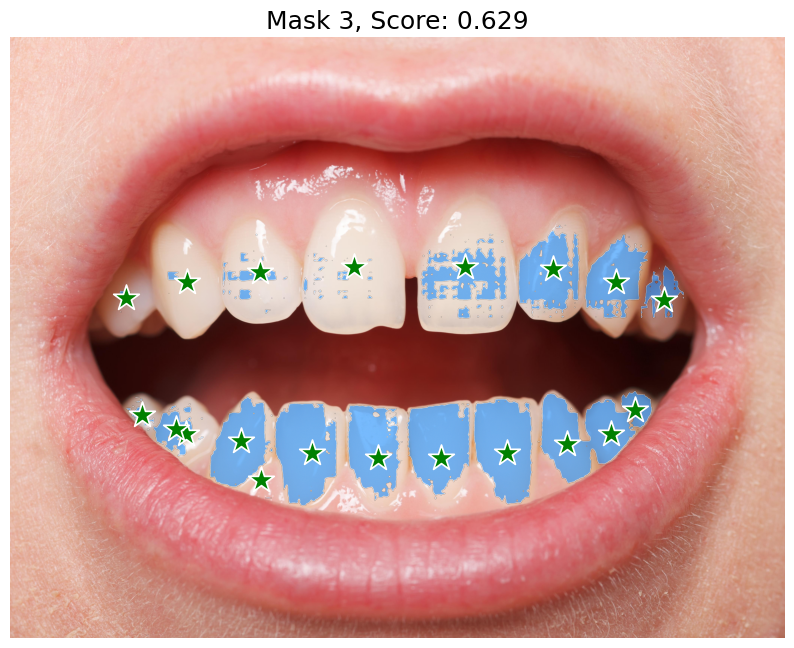

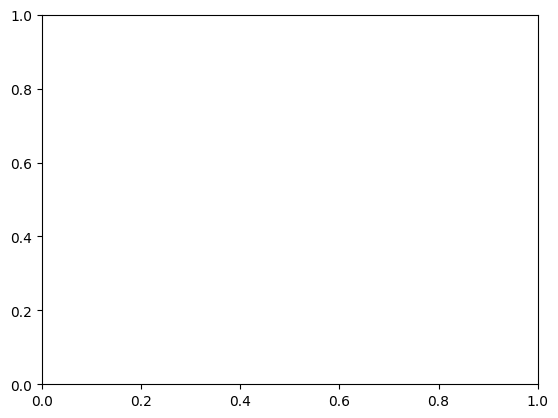

❌ Erreur lors du traitement de [[[240 188 167]
  [238 186 165]
  [236 184 163]
  ...
  [241 195 180]
  [240 194 179]
  [239 193 178]]

 [[240 187 169]
  [239 187 166]
  [238 185 167]
  ...
  [241 195 180]
  [240 194 179]
  [239 193 178]]

 [[239 186 170]
  [239 186 168]
  [240 187 171]
  ...
  [242 195 179]
  [241 194 178]
  [240 193 177]]

 ...

 [[218 163 143]
  [218 163 143]
  [218 163 143]
  ...
  [173 107  85]
  [172 106  84]
  [172 106  84]]

 [[218 163 143]
  [218 163 143]
  [218 163 143]
  ...
  [173 107  85]
  [172 106  84]
  [172 106  84]]

 [[218 163 143]
  [218 163 143]
  [218 163 143]
  ...
  [173 107  85]
  [172 106  84]
  [172 106  84]]] : Format '\n  [173 107  85]\n  [172 106  84]\n  [172 106  84]]]' is not supported (supported formats: eps, jpeg, jpg, pdf, pgf, png, ps, raw, rgba, svg, svgz, tif, tiff, webp)
les input : []
labels : []
❌ Erreur lors du traitement de [[[ 85  25  24]
  [ 85  25  24]
  [ 85  25  24]
  ...
  [219 121 112]
  [219 121 112]
  [219 121 112]]

 

<Figure size 640x480 with 0 Axes>

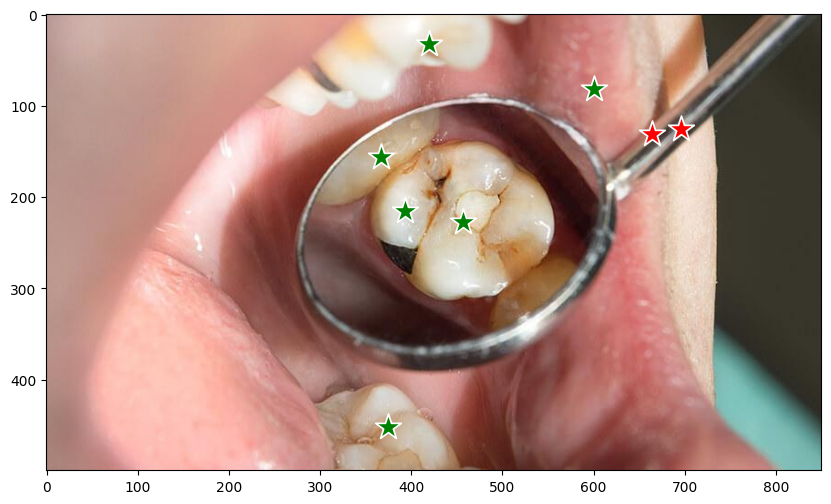

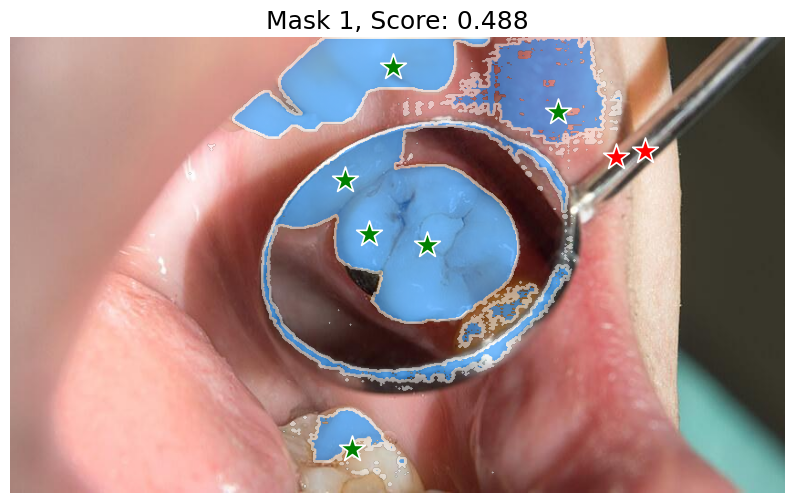

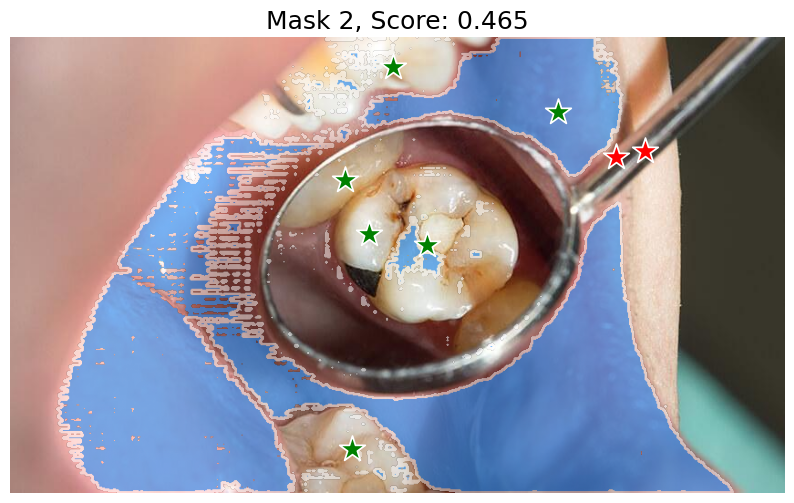

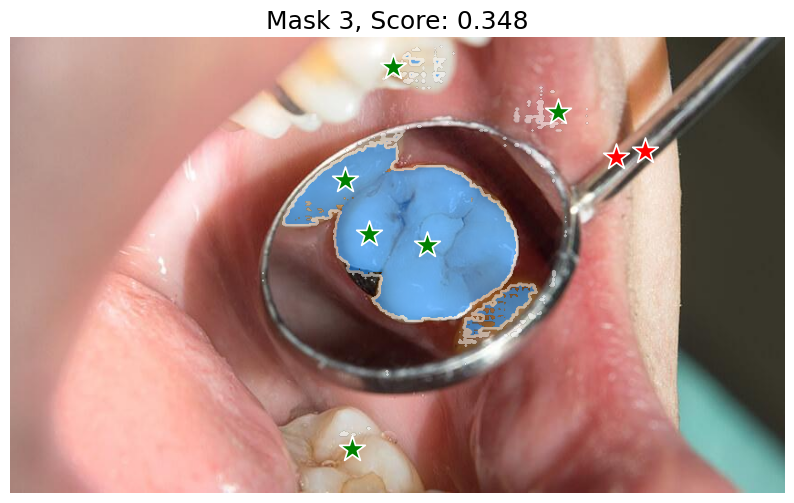

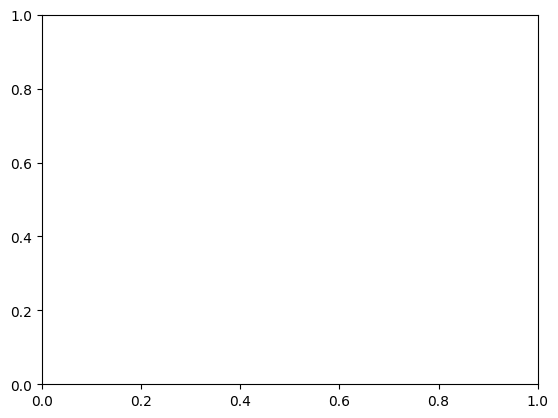

❌ Erreur lors du traitement de [[[184 153 150]
  [184 153 150]
  [184 153 150]
  ...
  [ 64  65  57]
  [ 60  57  48]
  [ 60  58  46]]

 [[184 153 150]
  [184 153 150]
  [184 153 150]
  ...
  [ 61  62  54]
  [ 58  55  46]
  [ 58  56  44]]

 [[184 153 150]
  [184 153 150]
  [184 153 150]
  ...
  [ 57  58  50]
  [ 57  54  45]
  [ 57  55  43]]

 ...

 [[166 129 121]
  [167 130 122]
  [168 131 123]
  ...
  [121 183 178]
  [120 183 175]
  [120 183 175]]

 [[166 129 121]
  [167 130 122]
  [168 131 123]
  ...
  [121 183 178]
  [120 183 175]
  [120 183 175]]

 [[166 129 121]
  [167 130 122]
  [168 131 123]
  ...
  [121 183 178]
  [121 184 176]
  [121 184 176]]] : Format '\n  [121 183 178]\n  [121 184 176]\n  [121 184 176]]]' is not supported (supported formats: eps, jpeg, jpg, pdf, pgf, png, ps, raw, rgba, svg, svgz, tif, tiff, webp)
les input : [[     3179.9      1651.5]
 [     1686.6      1546.1]
 [     2420.1      1677.8]
 [     4339.5      1572.4]
 [     3882.7      1616.3]
 [     1159.5   

<Figure size 640x480 with 0 Axes>

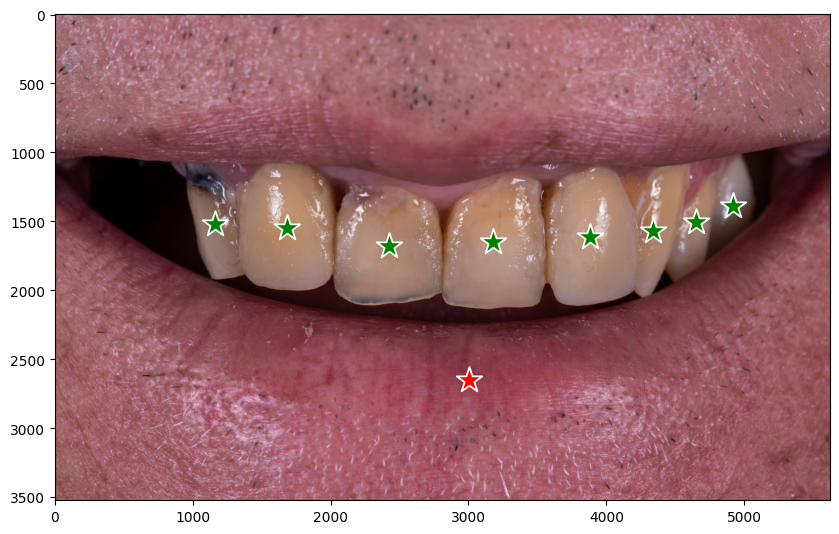

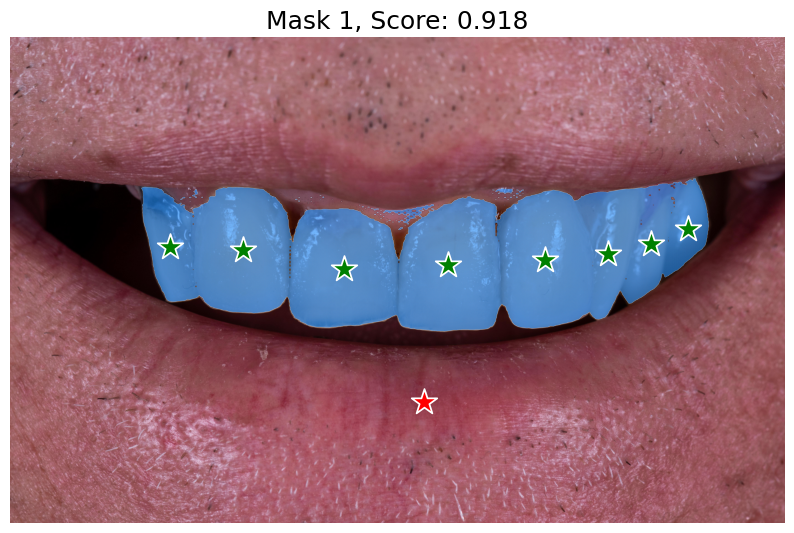

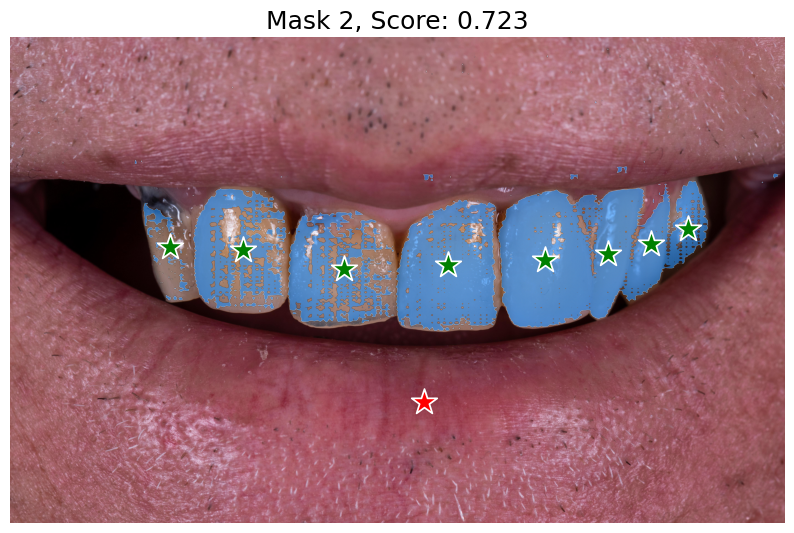

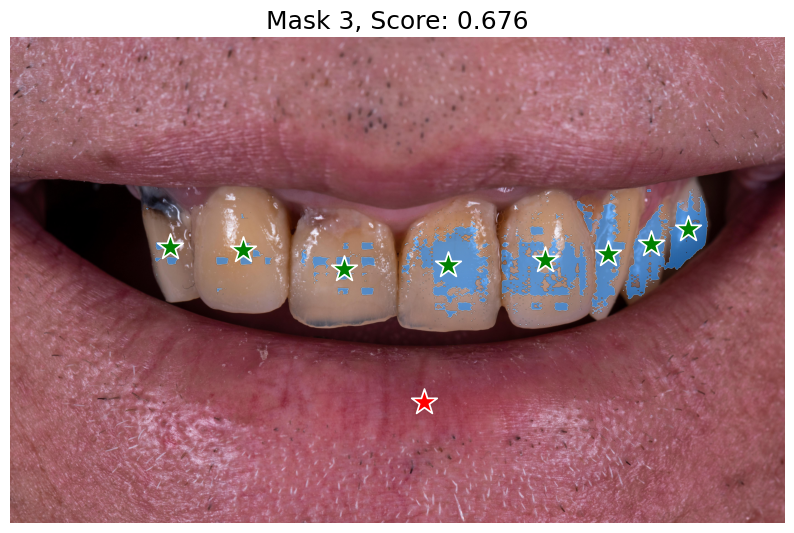

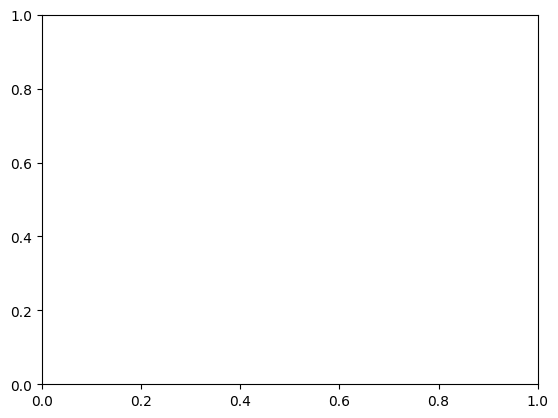

❌ Erreur lors du traitement de [[[160 101 107]
  [158  99 105]
  [156  99 105]
  ...
  [165 106 108]
  [168 109 111]
  [169 110 112]]

 [[159 100 106]
  [158  99 105]
  [155  98 104]
  ...
  [162 103 105]
  [165 106 108]
  [166 107 109]]

 [[159 100 106]
  [158  99 105]
  [156  99 105]
  ...
  [159 100 102]
  [161 102 104]
  [163 104 106]]

 ...

 [[142  86  87]
  [144  88  89]
  [146  90  91]
  ...
  [143  83  85]
  [143  83  85]
  [142  82  84]]

 [[146  90  91]
  [148  92  93]
  [150  94  95]
  ...
  [143  83  85]
  [143  83  85]
  [142  82  84]]

 [[148  92  93]
  [150  94  95]
  [151  95  96]
  ...
  [143  83  85]
  [143  83  85]
  [142  82  84]]] : Format '\n  [143  83  85]\n  [143  83  85]\n  [142  82  84]]]' is not supported (supported formats: eps, jpeg, jpg, pdf, pgf, png, ps, raw, rgba, svg, svgz, tif, tiff, webp)
les input : [[     2540.4      462.64]
 [     481.12      1823.2]
 [     559.13      792.51]
 [     2080.5      1571.3]
 [     819.88      1757.5]
 [     3328.8   

<Figure size 640x480 with 0 Axes>

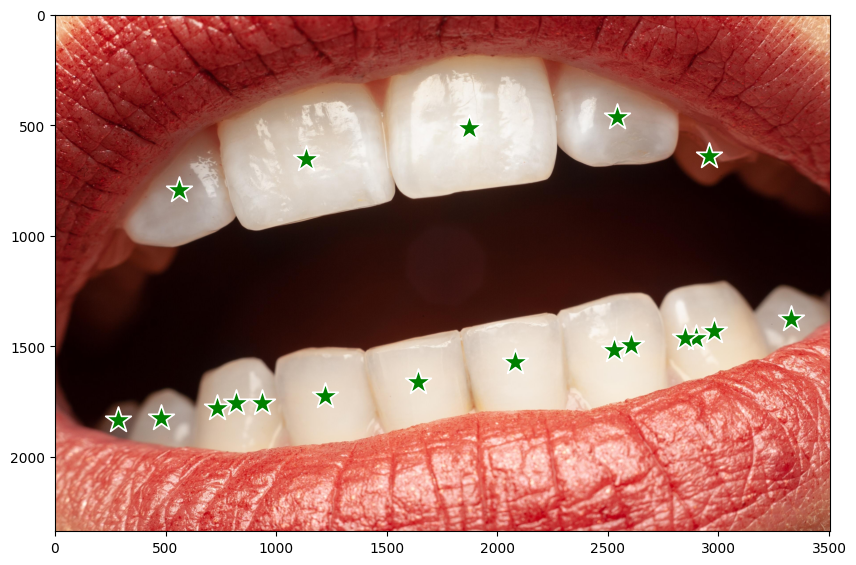

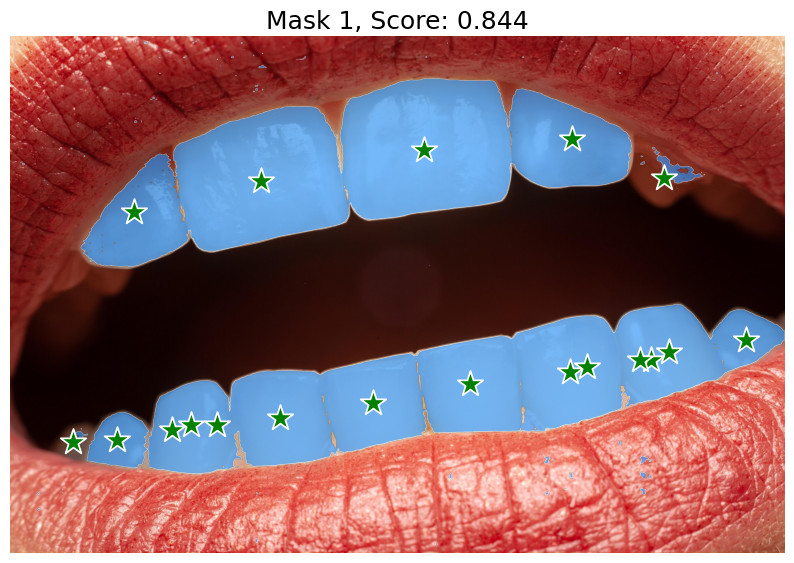

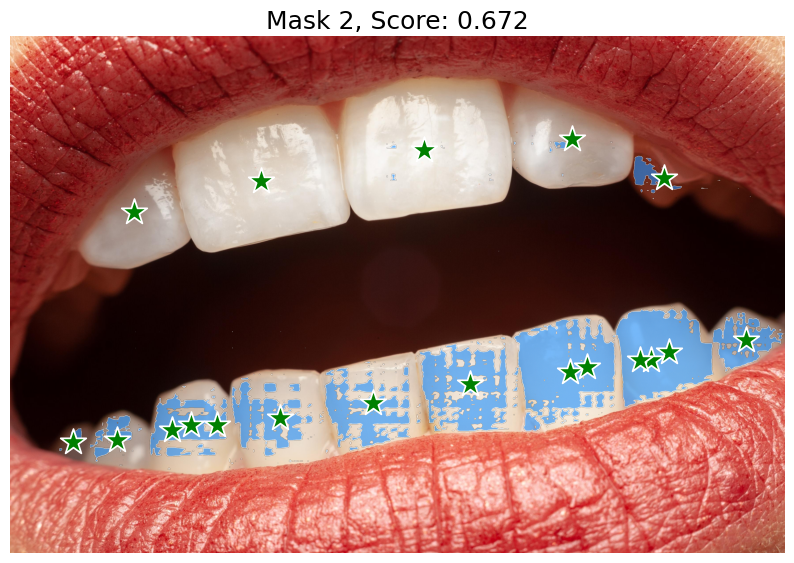

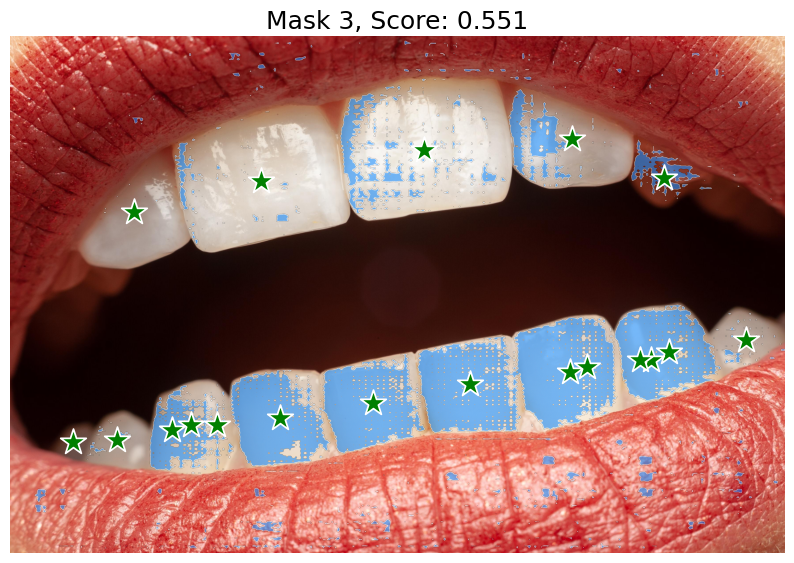

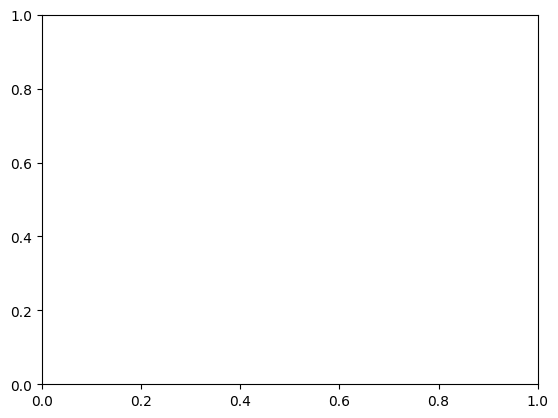

❌ Erreur lors du traitement de [[[255 203 159]
  [252 199 157]
  [248 196 156]
  ...
  [231 195 161]
  [235 197 161]
  [238 200 164]]

 [[253 199 155]
  [247 194 152]
  [242 190 150]
  ...
  [240 204 168]
  [245 207 171]
  [248 210 174]]

 [[252 198 154]
  [245 192 150]
  [238 186 146]
  ...
  [247 209 172]
  [251 211 175]
  [253 213 177]]

 ...

 [[203 138  98]
  [204 139  99]
  [205 140 100]
  ...
  [167 102  80]
  [171 106  84]
  [176 111  89]]

 [[205 140 100]
  [206 141 101]
  [206 143 102]
  ...
  [161  99  76]
  [163 101  78]
  [166 104  81]]

 [[206 141 101]
  [207 142 102]
  [207 144 103]
  ...
  [164 102  79]
  [166 104  81]
  [168 106  83]]] : Format '\n  [164 102  79]\n  [166 104  81]\n  [168 106  83]]]' is not supported (supported formats: eps, jpeg, jpg, pdf, pgf, png, ps, raw, rgba, svg, svgz, tif, tiff, webp)
les input : [[       2950        1400]
 [     3012.5        1200]
 [     2887.5        1175]
 [       3100      1437.5]
 [     3187.5        1425]
 [       2425   

<Figure size 640x480 with 0 Axes>

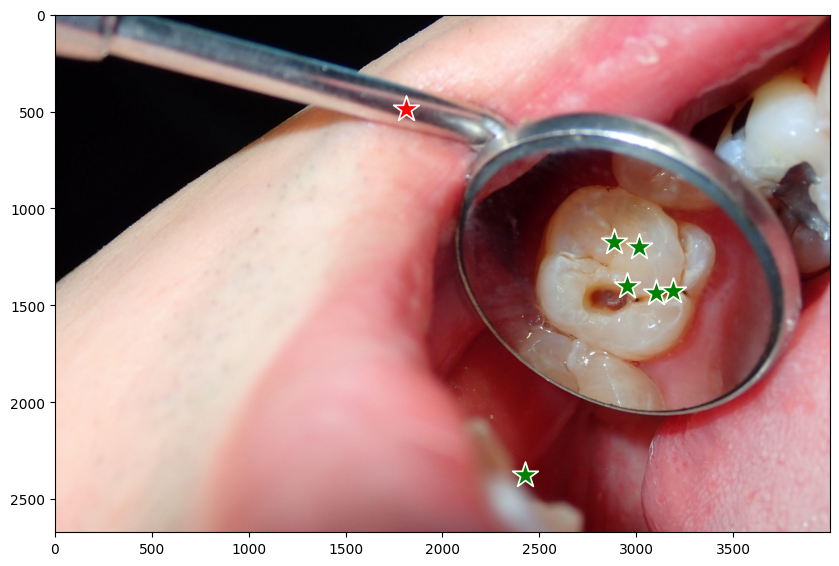

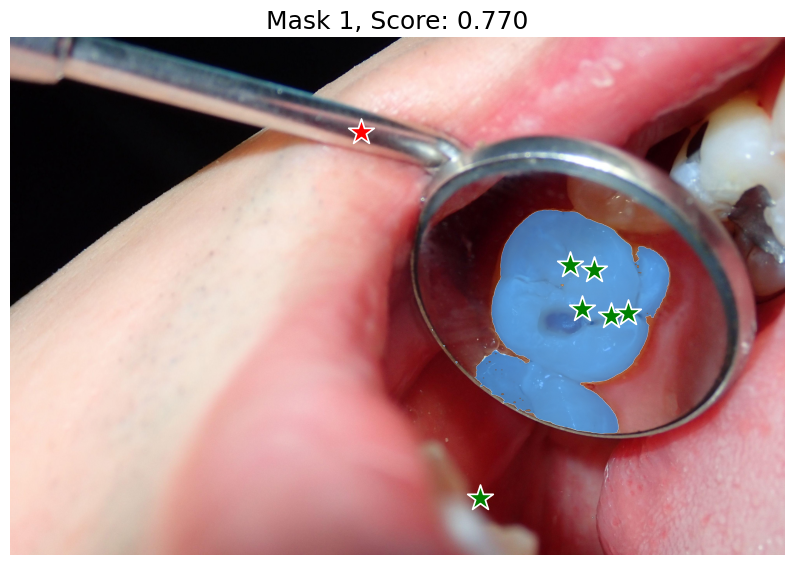

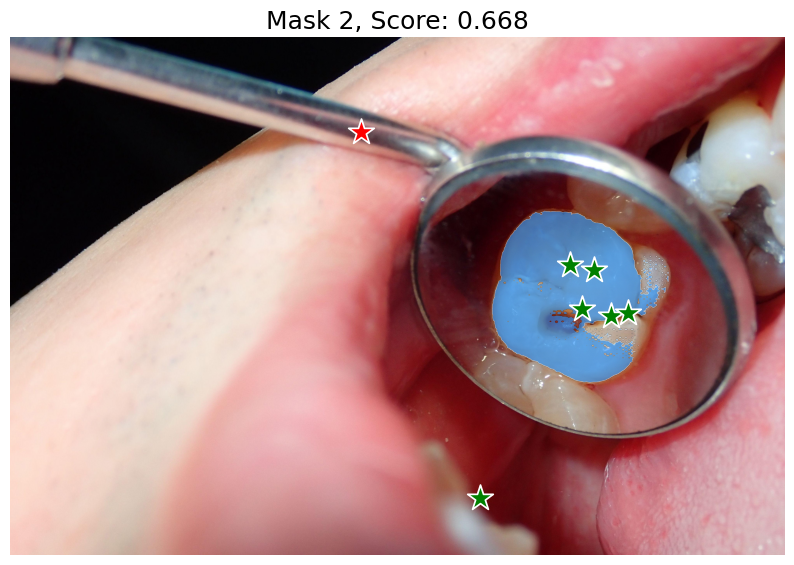

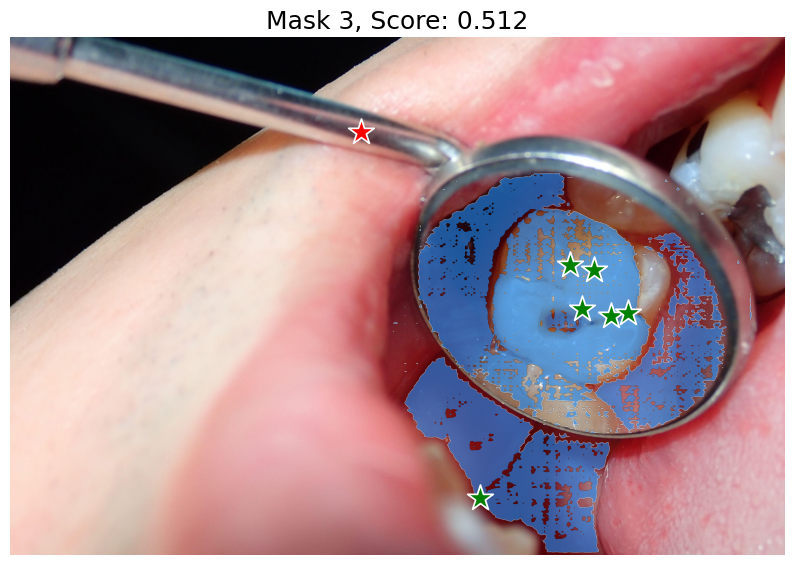

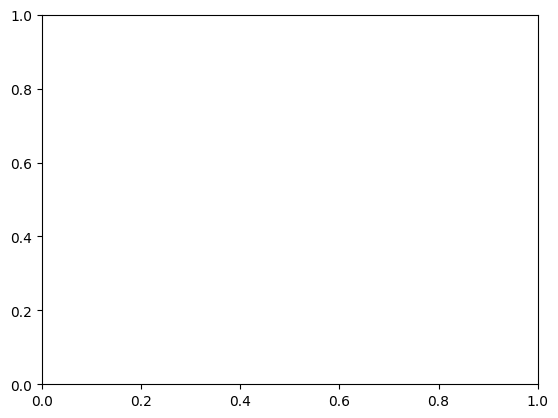

❌ Erreur lors du traitement de [[[ 91 106 125]
  [ 94 109 128]
  [ 92 107 126]
  ...
  [151  50  58]
  [145  43  54]
  [140  38  49]]

 [[ 92 107 126]
  [ 95 110 129]
  [ 94 109 128]
  ...
  [146  45  53]
  [144  42  53]
  [141  39  50]]

 [[ 91 106 125]
  [ 94 109 128]
  [ 94 109 128]
  ...
  [146  44  55]
  [145  43  54]
  [143  41  52]]

 ...

 [[245 201 190]
  [246 202 191]
  [247 203 192]
  ...
  [213 178 184]
  [213 178 184]
  [214 179 185]]

 [[246 202 191]
  [247 203 192]
  [248 204 193]
  ...
  [215 180 186]
  [215 180 186]
  [216 181 187]]

 [[247 203 192]
  [248 204 193]
  [248 204 193]
  ...
  [217 182 188]
  [217 182 188]
  [218 183 189]]] : Format '\n  [217 182 188]\n  [217 182 188]\n  [218 183 189]]]' is not supported (supported formats: eps, jpeg, jpg, pdf, pgf, png, ps, raw, rgba, svg, svgz, tif, tiff, webp)
les input : []
labels : []
❌ Erreur lors du traitement de [[[243 187 162]
  [243 187 162]
  [243 187 162]
  ...
  [181 128  86]
  [181 128  86]
  [180 127  85]]

 

<Figure size 640x480 with 0 Axes>

In [ ]:
# Dossiers
image_folder = "/content/input"
json_folder = "/content/json"
output_folder = "/content/output_resulats"


# Créer le dossier de sortie s'il n'existe pas
os.makedirs(output_folder, exist_ok=True)

# Boucle sur les images
for img_name in os.listdir(image_folder):
    if img_name.lower().endswith((".jpg", ".jpeg", ".png")):
        img_path = os.path.join(image_folder, img_name)
        json_path = os.path.join(json_folder, f"{os.path.splitext(img_name)[0]}.json")

        if not os.path.exists(json_path):
            print(f"⚠️ JSON non trouvé pour {img_name}")
            continue

        try:
            # Charger l'image
            image = Image.open(img_path)
            image = np.array(image.convert("RGB"))

            # Charger les points du JSON
            with open(json_path, "r") as json_file:
                json_data = json.load(json_file)

            dents = json_data.get("dent", [])
            autres = json_data.get("autre", [])

            # Création des inputs pour le modèle
            input_points = np.array(dents + autres)
            print('les input :',input_points)
            input_labels = np.array([1] * len(dents) + [0] * len(autres))  # 1 = dent, 0 = autre
            print('labels :',input_labels)
            # Passer l'image dans le modèle
            predictor.set_image(image)

            # Prédiction des masques
            masks, scores, logits = predictor.predict(
                point_coords=input_points,
                point_labels=input_labels,
                multimask_output=True,
            )

            # Trier les résultats par score
            sorted_ind = np.argsort(scores)[::-1]
            masks = masks[sorted_ind]
            scores = scores[sorted_ind]
            logits = logits[sorted_ind]

            # Affichage des résultats
            plt.figure(figsize=(10, 10))
            plt.imshow(image)
            show_points(input_points, input_labels, plt.gca())
            show_masks(image, masks, scores, point_coords=input_points, input_labels=input_labels, borders=True)
            plt.axis('on')
            plt.show()

            # Enregistrement des résultats
            output_path = os.path.join(output_folder, f"result_{image}")
            plt.savefig(output_path)
            plt.close()  # Fermer la figure pour libérer la mémoire

            print(f"✅ Résultat enregistré : {output_path}")

        except Exception as e:
            print(f"❌ Erreur lors du traitement de {image} : {e}")


# Interface upload une image de dent

Ce code réalise plusieurs étapes d'analyse d'image :

1. Il permet de télécharger une image via Google Colab et de la renommer pour traitement.
2. Un modèle YOLO est utilisé pour détecter des objets dans l'image, et les résultats de détection sont sauvegardés dans un fichier JSON.
3. Ensuite, le modèle SAM (Segment Anything Model) est utilisé pour segmenter les objets détectés par YOLO, générant ainsi des masques pour chaque objet.
4. Enfin, les résultats sont affichés avec trois images côte à côte : l'image originale, les points détectés par YOLO, et l'image avec les masques de segmentation générés par SAM.

Cela permet de visualiser l'interaction entre détection d'objets et segmentation des objets sur l'image.

Saving 103_jpg.rf.8ce6d1e50ce178132fc20124134d4afd.jpg to 103_jpg.rf.8ce6d1e50ce178132fc20124134d4afd.jpg
✅ Image chargée : /content/uploaded_image.jpg

image 1/1 /content/uploaded_image.jpg: 512x640 20 dents, 59.8ms
Speed: 3.5ms preprocess, 59.8ms inference, 1.6ms postprocess per image at shape (1, 3, 512, 640)
✅ Détection enregistrée dans /content/detection.json


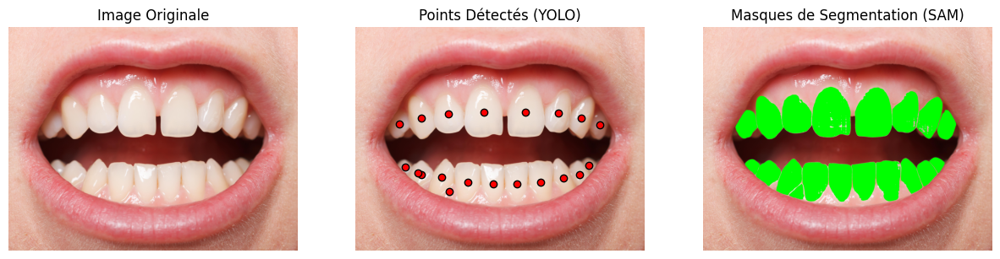

In [ ]:
from google.colab import files
import os
import torch
import json
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image, ImageDraw
from ultralytics import YOLO
import cv2

# Définition des chemins
temp_image_path = "/content/uploaded_image.jpg"
temp_json_path = "/content/detection.json"

# Étape 1 : Upload d'une image
uploaded = files.upload()
image_name = list(uploaded.keys())[0]
os.rename(image_name, temp_image_path)
print(f"✅ Image chargée : {temp_image_path}")

# Étape 2 : Prédiction YOLO
def detect_objects(image_path, model):
    results = model(image_path)
    detections = []
    class_names = model.names

    for result in results:
        for box in result.boxes:
            cls = int(box.cls[0])
            xyxy = box.xyxy[0].tolist()
            class_label = class_names[cls]
            detections.append({"class": class_label, "bbox": xyxy})

    with open(temp_json_path, "w") as json_file:
        json.dump(detections, json_file, indent=4)
    print(f"✅ Détection enregistrée dans {temp_json_path}")
    return detections

# Charger le modèle YOLO
model_yolo = YOLO("/content/runs/detect/train2/weights/best.pt")
detections = detect_objects(temp_image_path, model_yolo)

# Étape 3 : Segmentation avec SAM
def segment_with_sam(image_path, detections, sam_predictor):
    image = cv2.imread(image_path)
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    sam_predictor.set_image(image_rgb)

    masks = []
    for detection in detections:
        bbox = np.array(detection["bbox"], dtype=np.float32)
        mask, _, _ = sam_predictor.predict(box=bbox[None, :], multimask_output=True)
        masks.append(mask[0])  # On prend le premier masque généré

    return masks, image_rgb

# Charger le modèle SAM


masks, image_rgb = segment_with_sam(temp_image_path, detections, predictor)

# Étape 4 : Affichage des résultats
def display_results(image_rgb, detections, masks):
    plt.figure(figsize=(15, 5))

    # Image originale
    plt.subplot(1, 3, 1)
    plt.imshow(image_rgb)
    plt.title("Image Originale")
    plt.axis("off")

    # Image avec points détectés
    plt.subplot(1, 3, 2)
    plt.imshow(image_rgb)
    for detection in detections:
        bbox = detection["bbox"]
        x_center = (bbox[0] + bbox[2]) / 2
        y_center = (bbox[1] + bbox[3]) / 2
        plt.scatter(x_center, y_center, color='red', edgecolors='black')
    plt.title("Points Détectés (YOLO)")
    plt.axis("off")

    # Image avec segmentation SAM
    plt.subplot(1, 3, 3)
    overlay = image_rgb.copy()
    for mask in masks:
        overlay[mask > 0] = [0, 255, 0]  # Colorer les zones segmentées en vert
    plt.imshow(overlay)
    plt.title("Masques de Segmentation (SAM)")
    plt.axis("off")

    plt.show()

# Affichage final
display_results(image_rgb, detections, masks)


# Prompt avec GPT

Dans cette section, nous détaillons les différentes interactions avec ChatGPT qui nous ont permis d’affiner notre approche et d’obtenir des résultats optimaux pour notre projet. Vous pouvez trouver notre conversation avec gpt à travers ce lien: https://chatgpt.com/share/67bba034-1654-8011-b324-fba2eff2d519

## Premier prompt : Détection d’objets avec YOLO

**Prompt initial :**
```text
"c'est bien , sauf , que tu as pris seulement le model YOLO,
il me faut aussi le model SAM2 ,et afficher ses outputs"

**Amélioration apportée** :
L'ajout du modèle SAM2 en complément de YOLO pour la segmentation des objets détectés. Cela permet d'obtenir non seulement les boîtes englobantes des objets mais aussi des masques plus précis.

## Deuxième prompt : Génération du fichier de configuration pour YOLO

**Prompt initial** :
"je veux creer un fichier en executant du code dont le contenu est :
train : /content/custom_dataset/train
val : /content/custom_dataset/val
nc : 2
names : ['autre', 'dent']
et le chemin : /content/model/dataset_custom.yaml"
**Amélioration apportée** :
Génération automatique du fichier YAML à l'emplacement spécifié, permettant une configuration rapide du modèle YOLO pour l’entraînement sur un dataset personnalisé.

## Troisième prompt : Téléchargement du modèle YOLO

**Prompt initial** :
"comment telecharger ca aussi directement et mettre dans ce répertoire ? :
model = YOLO('/content/model/yolo11m.pt')"

**Amélioration apportée** :
Ajout d'un script permettant de télécharger automatiquement le fichier yolo11m.pt et de le placer dans le bon répertoire pour une utilisation immédiate.

## Quatrième prompt : Téléchargement d’un dataset depuis KaggleHub

**Prompt initial** :
"je veux que ça télécharge ça :

import kagglehub  
# Download latest version  
path = kagglehub.dataset_download('pawanvalluri/dental-segmentation')  
print('Path to dataset files:', path)  

que ça récupère les 10 premières images et que ça les mette dans un dossier"

**Amélioration apportée** :
Ajout d’un script qui non seulement télécharge le dataset mais extrait également les 10 premières images et les stocke dans un dossier spécifique, facilitant ainsi le prétraitement des données.

# CONCLUSION

Nous avons développé une approche combinant YOLO et SAM 2 pour automatiser la segmentation des dents à partir d’images classiques de la bouche. En utilisant YOLO pour détecter automatiquement les régions d’intérêt et SAM 2 pour générer des masques de segmentation précis, nous avons supprimé la nécessité d’annotations manuelles tout en améliorant l’efficacité du processus.

Cette méthodologie offre un bon compromis entre rapidité et précision, mais sa performance reste dépendante de la qualité des détections initiales de YOLO. Une mauvaise localisation des dents peut en effet impacter la segmentation finale. De plus, SAM 2 générant plusieurs masques candidats, une stratégie de sélection optimale reste un enjeu clé.

Pour améliorer notre approche, il serait pertinent d’optimiser les prompts envoyés à SAM 2, d’intégrer un post-traitement pour affiner les résultats et d’explorer d’autres architectures de segmentation. Cette méthode pourrait aussi être appliquée à d’autres domaines d’imagerie biomédicale nécessitant une segmentation automatique fiable.